In [44]:
from scipy.signal import butter, filtfilt
import pandas as pd
import numpy as np
from pathlib import Path
from nptdms import TdmsFile

def bandpass_filter(signal, fs=25600, lowcut=10, highcut=10000, order=4):
    signal -= signal.mean()
    nyq = 0.5 * fs
    low = lowcut / nyq
    high = highcut / nyq
    b, a = butter(order, [low, high], btype='band')
    return  filtfilt(b, a, signal)

def load_tdms_file(file_path):
    tdms_file = TdmsFile.read(file_path)

    group_name_vibration = tdms_file.groups()[0].name
    group_name_operation = tdms_file.groups()[1].name

    vib_channels = tdms_file[group_name_vibration].channels()
    vib_data = {ch.name: ch.data for ch in vib_channels}
    
    operation_data = {
        ch.name: float(ch.data[0])  # ch.data가 np.array([xyz]) → float(xyz)
        for ch in tdms_file[group_name_operation].channels()
    }

    return vib_data , operation_data

In [43]:
from scipy.stats import entropy
import numpy as np
from scipy.fft import rfft, rfftfreq

def compute_fft(signal, sampling_rate=25600):
    fft_vals = np.abs(rfft(signal))
    freqs = rfftfreq(len(signal), d=1/sampling_rate)
    return  freqs, fft_vals

def extract_fft_features(freqs, fft_vals):

    features = {}

    P = fft_vals / (np.sum(fft_vals) + 1e-10)

    total_power = np.sum(fft_vals**2) # "신호가 주파수 영역에 얼마나 많은 에너지를 갖고 있는가" - 스펙트럼 전체 진폭을 제곱하여 모두 더한 값
    max_frequency = freqs[np.argmax(fft_vals)] # "신호에서 가장 우세한(강한) 주파수가 무엇인가" - 진폭이 가장 큰 스펙트럼 성분의 인덱스를 찾아, 그때때의 주파수를 반환
    mean_frequency = np.sum(freqs * fft_vals) / np.sum(fft_vals) # "스펙트럼 에너지 중심이 전체 주파수 대역 어디쯤에 위치하는가" - 진폭을 가중치로 한 주파수의 평균(무게중심)
    median_frequency = freqs[np.cumsum(fft_vals) >= np.sum(fft_vals)/2][0] # "에너지가 절반 이하인 주파수 대역을 가르는 중간값" - 누적 진폭이 전체의 절반에 도달하는 지점을 찾아 그 주파수를 반환
    spectral_skewness = np.mean((freqs - mean_frequency)**3 * fft_vals) / (np.std(freqs) + 1e-10)**3 # 주파수 분포의 왜도(비대칭도) - 값이 양수면 고주파 쪽 꼬리가 길고, 음수면 저주파 쪽 꼬리가 길다는 의미
    spectral_kurtosis = np.mean((freqs - mean_frequency)**4 * fft_vals) / (np.std(freqs) + 1e-10)**4 # 주파수 분포의 첨도(뾰족함) - 값이 크면 스펙트럼 에너지가 특정 주파수에 집중되어 있다는 뜻
    peak_amplitude = np.max(fft_vals) # "최대 진폭(energy peak)의 세기" - 스펙트럼 진폭 중 가장 큰 값 그 자체를 반환
    band_energy = np.sum(fft_vals[(freqs>=0.1)&(freqs<=1.0)]**2) # "관심 주파수 구간의 에너지 총량" - 특정 대역(이 경우 0.1~1.0Hz) 내 진폭 제곱합
    dominant_frequency_power = fft_vals[np.argmax(fft_vals)]**2 # "가장 우세한 주파수 성분에 얼마나 많은 에너지가 집중되어있는가" - 최대 진폭 성분의 에너지를 별도로 제곱해 계산
    spectral_entropy = -np.sum(P * np.log2(P + 1e-10)) # 값이 클수록 주파수 에너지가 고르게 분포되어 있다는 뜻 - 스펙트럼을 확률분포로 보고 엔트로피를 구한다
    rms_frequency = np.sqrt(np.mean(fft_vals**2)) # "스펙트럼 진폭의 전반적인 크기(표준적인 에너지 수준)를 요약한다" - 진폭의 제곱 편균의 제곱근(rms)
    variance_frequency = np.var(fft_vals) # "스펙트럼 진폭이 얼마나 퍼져 있는가(산포도)" - 진폭 값들의 분산을 계산한다.

    features = {
        "total_power": total_power,
        "max_frequency": max_frequency,
        "mean_frequency": mean_frequency,
        "median_frequency": median_frequency,
        "spectral_skewness": spectral_skewness,
        "spectral_kurtosis": spectral_kurtosis,
        "peak_amplitude": peak_amplitude,
        "band_energy_0.1_1Hz": band_energy,
        "dominant_frequency_power": dominant_frequency_power,
        "spectral_entropy": spectral_entropy,
        "rms_frequency": rms_frequency,
        "variance_frequency": variance_frequency
    }
    return features


In [3]:
def extract_time_features(signal):
    features = {}
    signal_mean = np.mean(signal)
    signal_std = np.std(signal)
    signal_max = np.max(signal)
    signal_min = np.min(signal)
    signal_rms = np.sqrt(np.mean(signal**2))
    signal_skew = np.mean((signal - signal_mean)**3) / (signal_std**3 + 1e-10)
    signal_kurt = np.mean((signal - signal_mean)**4) / (signal_std**4 + 1e-10)
    signal_peak = np.max(np.abs(signal))
    signal_p2p = signal_max - signal_min  # Peak-to-Peak
    signal_crest = signal_peak / (signal_rms + 1e-10)
    signal_impulse = signal_peak / (np.mean(np.abs(signal)) + 1e-10)
    signal_shape = signal_rms / (np.mean(np.abs(signal)) + 1e-10)
    
    features.update({
        "mean": signal_mean,
        "std": signal_std,
        "max": signal_max,
        "min": signal_min,
        "rms": signal_rms,
        "skewness": signal_skew,
        "kurtosis": signal_kurt,
        "peak": signal_peak,
        "ppv": signal_p2p,
        "crest_factor": signal_crest,
        "impulse_factor": signal_impulse,
        "shape_factor": signal_shape
    })
    
    return features

In [30]:
def compute_order_spectrum(sig, fs, rpm):
    f_rot = rpm / 60.0
    N = len(sig)
    spec = np.abs(rfft(sig))
    freqs = rfftfreq(N, d=1/fs)
    orders = freqs / (f_rot + 1e-10)
    return orders, spec

def extract_order_features(orders, spec, max_order=10):
    feats = {}
    for n in range(1, max_order+1):
        idx = np.argmin(np.abs(orders - n))
        feats[f"order_{n}"] = spec[idx]
    return feats

def extract_order_harmonic(orders, spec, harmonics=10, points_per_harmonic=30, log_scale=True, min_max=False):
    harmonic_orders = np.concatenate([
        np.linspace(i + 0.5, i + 1.0, points_per_harmonic)
        for i in range(harmonics)
    ])

    waveform = np.interp(harmonic_orders, orders, spec)
    if log_scale:
        waveform = np.log1p(waveform)

    if min_max:
        min_v = waveform.min()
        max_v = waveform.max()
        waveform = (waveform - min_v) / (max_v - min_v + 1e-10)

    return harmonic_orders, waveform

In [ ]:
import matplotlib.pyplot as plt
import matplotlib.pyplot as plt, gc
import os

def process_file(path, rpm):
    vib_data, op_data = load_tdms_file(path)
    all_feats = {}
    for ch, sig in vib_data.items():
        # 1) Time-domain
        tf = extract_time_features(sig)
        all_feats.update({f"{ch}_{key}":v for key,v in tf.items()})
        
        # 2) Frequency-domain
        filt = bandpass_filter(sig)
        freqs, fftv = compute_fft(filt)
        print(freqs.shape)
        print(fftv.shape)
        ff = extract_fft_features(freqs, fftv)
        all_feats.update({f"{ch}_{key}":v for key,v in ff.items()})
        
        # 3) Order-domain
        orders, spec = compute_order_spectrum(filt, fs=25600, rpm=rpm)
        of = extract_order_features(orders, spec, max_order=10)
        all_feats.update({f"{ch}_{key}":v for key,v in of.items()})
    
    # 4) 운전 조건
    for k, arr in op_data.items():
        all_feats[k] = arr[0]
    
    return all_feats

def visualize_tdms_file(path, ch, rpm, save_dir=None, fs=25600, show=True):
    # 1) 데이터 로드
    vib_data, _ = load_tdms_file(path)
    sig = vib_data[f"CH{ch}"]

    # 2) 필터링
    filt_sig = bandpass_filter(sig, fs=fs, lowcut=10, highcut=10000, order=4)

    # 3) 시간축
    t = np.arange(len(sig)) / fs

    # 4) FFT
    freqs, fft_vals = compute_fft(filt_sig, sampling_rate=fs)
    print(freqs.shape)
    print(fft_vals.shape)

    # 5) Order spectrum
    orders, spec = compute_order_spectrum(filt_sig, fs=fs, rpm=rpm)

    # 6) Plot
    fig, axs = plt.subplots(4, 1, figsize=(10, 12))

    axs[0].plot(t, sig, linewidth=0.8)
    axs[0].set_title(f"Raw Time-Domain Signal (CH{ch})")
    axs[0].set_xlabel("Time [s]")
    axs[0].set_ylabel("Amplitude")

    axs[1].plot(t, filt_sig, linewidth=0.8)
    axs[1].set_title("Filtered Time-Domain Signal (10–10kHz)")
    axs[1].set_xlabel("Time [s]")
    axs[1].set_ylabel("Amplitude")

    axs[2].plot(freqs, fft_vals, linewidth=0.8)
    axs[2].set_title(f"Frequency Spectrum (CH{ch})")
    axs[2].set_xlabel("Frequency [Hz]")
    axs[2].set_ylabel("Amplitude")
    axs[2].set_xlim(0, fs/2)

    axs[3].plot(orders, spec, linewidth=0.8)
    axs[3].set_title(f"Order Freq (CH{ch}) at {rpm} RPM")
    axs[3].set_xlabel("Order (×)")
    axs[3].set_ylabel("Amplitude")
    axs[3].set_xlim(0, 10)
    axs[3].relim()
    axs[3].autoscale()

    if save_dir is not None:
        os.makedirs(save_dir, exist_ok=True)
        base = os.path.splitext(os.path.basename(path))[0]
        fname = f"{base}_CH{ch}.png"
        fig_path = os.path.join(save_dir, fname)
        fig.savefig(fig_path, dpi=300)
        print(f"Saved figure to {fig_path}")

    plt.tight_layout()
    if show == True:
        plt.show()
    
    # plt.close(fig)
    # plt.close('all')
    # gc.collect()       # 가비지 컬렉터 강제 실행

test_path = "Train_Set\Train1\modified_KIMM Simulator_KIMM Bearing Test_20160325122639.tdms"

In [6]:
import matplotlib.pyplot as plt, gc
plt.close('all')   # 열린 모든 Figure 닫기
gc.collect()       # 가비지 컬렉터 강제 실행

50

(128001,)
(128001,)
Saved figure to plot/Train1\modified_KIMM Simulator_KIMM Bearing Test_20160325122639_CH1.png


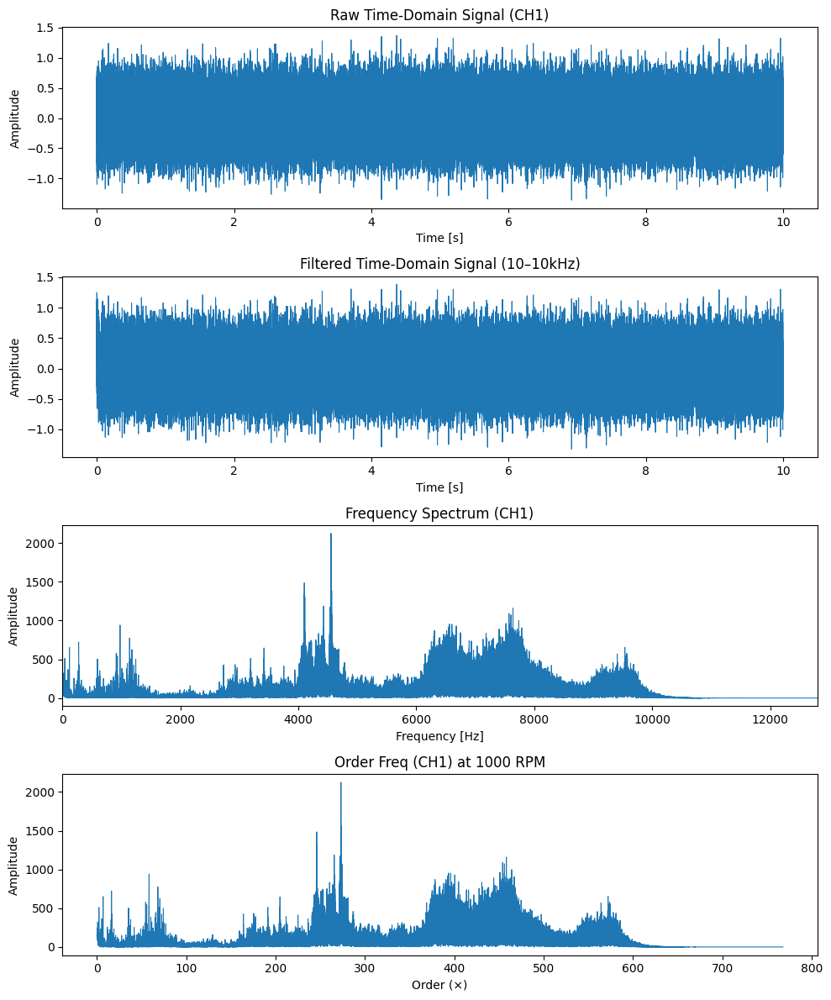

In [7]:
visualize_tdms_file(test_path, ch=1, rpm=1000, save_dir=f"plot/Train{1}", fs=25600, show=True)

In [8]:
from glob import glob

# for Nset in range(1, 9):
#     for ch in range(1, 5):
#         folder_path = f"Train_Set\Train{Nset}"
#         file_list = sorted(glob(f"{folder_path}/*.tdms"))
#         for i, path in enumerate(file_list):
#             visualize_tdms_file(path, ch=ch, rpm=1000, save_dir=f"plot/Train{Nset}", fs=25600, show=False)
#             plt.close('all')   # 열린 모든 Figure 닫기
#             gc.collect()       # 가비지 컬렉터 강제 실행



In [73]:
from glob import glob
from mpl_toolkits.mplot3d import Axes3D

def visualize_folder_fft_surface(folder_path, ch, rpm, fs=25600, folder=True):
    
    if folder==True:
        # 폴더 내 tdms 파일 불러오기
        file_list = sorted(glob(f"{folder_path}/*.tdms"))
    elif folder==False:
        file_list = [folder_path]
    n_files = len(file_list)

    spectra = []
    for i, path in enumerate(file_list):
        vib_data, _ = load_tdms_file(path)
        sig = vib_data[f"CH{ch}"]
        filt = bandpass_filter(sig, fs=fs)
        freqs, fft_vals = compute_fft(filt, sampling_rate=fs)
        spectra.append(fft_vals)
    
    Z = np.vstack(spectra)
    X, Y = np.meshgrid(freqs, np.arange(n_files))

    fig = plt.figure(figsize=(12, 6))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(X, Y, Z, cmap='viridis', linewidth=0, antialiased=True)

    ax.set_xlabel("Frequency [Hz]")
    ax.set_ylabel("File Index")
    ax.set_zlim(0, 3000)
    ax.set_zlabel("Amplitude")
    ax.set_title(f"Folder FFT Surface (CH{ch})")

    fig.colorbar(surf, ax=ax, label="Amplitude")
    plt.show()

def visualize_folder_rms_surface(folder_path, ch, save_dir, fs=25600):
    file_list = sorted(glob(f"{folder_path}/*.tdms"))
    n_files = len(file_list)
    if n_files == 0:
        raise FileNotFoundError(f"No .tdms files in {folder_path}")
    
    rms_values = []
    fft_freqs = None
    
    for path in file_list:
        vib_data, _ = load_tdms_file(path)
        sig = vib_data[f"CH{ch}"]
        filt_sig = bandpass_filter(sig, fs=fs)
        freqs, fft_vals = compute_fft(filt_sig, sampling_rate=fs)
        features = extract_fft_features(freqs=freqs, fft_vals=fft_vals)
        rms_values.append(features["rms_frequency"])

    fig = plt.figure(figsize=(10, 4))
    plt.plot(rms_values, marker=',', linestyle='-', color='tab:blue')
    plt.title(f"RMS Trend over Files CH{ch}")
    plt.xlabel("File Index")
    plt.ylabel("RMS Amplitude")
    plt.grid(True)
    plt.tight_layout()

    if save_dir is None:
        save_dir = os.path.join(folder_path, "plots")
    os.makedirs(save_dir, exist_ok=True)

    save_path = os.path.join(
        save_dir,
        f"{os.path.basename(folder_path.rstrip(os.sep))}_rms_CH{ch}.png"
    )
    fig.savefig(save_path, dpi=300)
    print(f"✅ Plot saved to: {save_path}")

    plt.show()

    

Train_Set/Train1_1_rms
✅ Plot saved to: rms_plot\Train1_rms_CH1.png


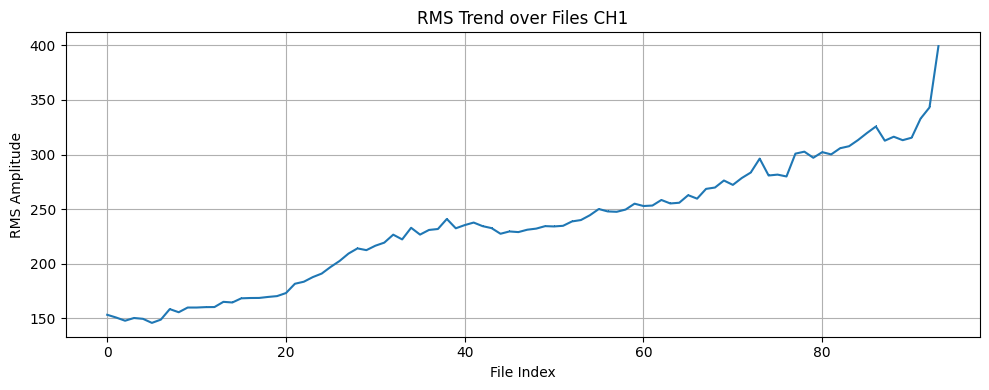

Train_Set/Train1_2_rms
✅ Plot saved to: rms_plot\Train1_rms_CH2.png


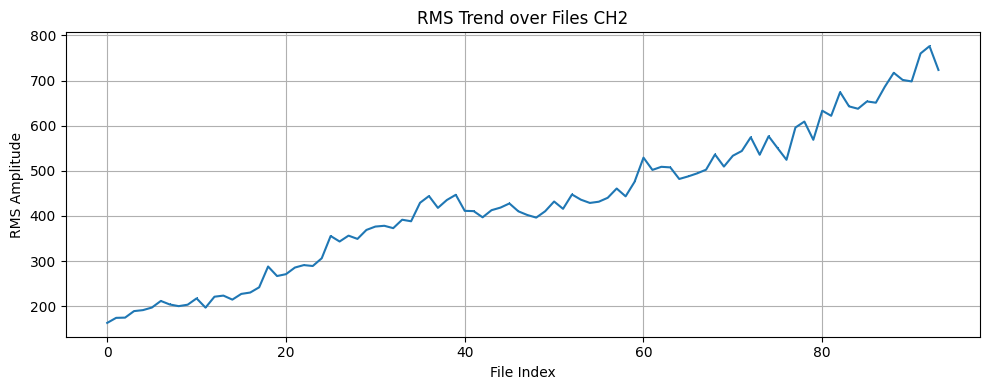

Train_Set/Train1_3_rms
✅ Plot saved to: rms_plot\Train1_rms_CH3.png


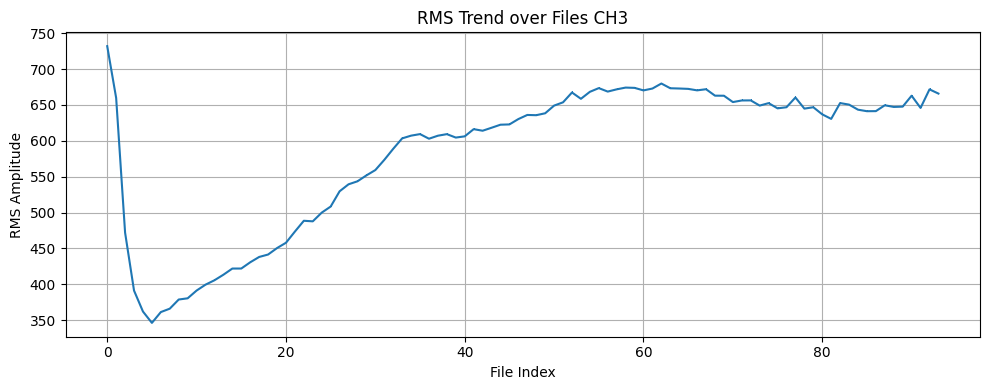

Train_Set/Train1_4_rms
✅ Plot saved to: rms_plot\Train1_rms_CH4.png


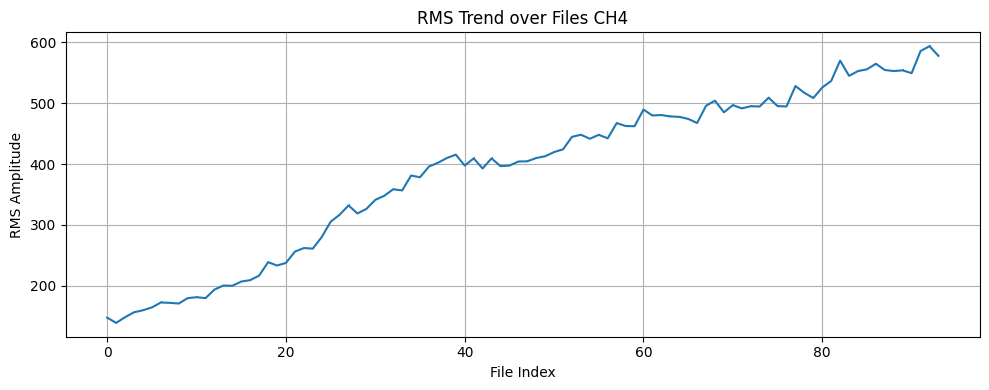

Train_Set/Train2_1_rms
✅ Plot saved to: rms_plot\Train2_rms_CH1.png


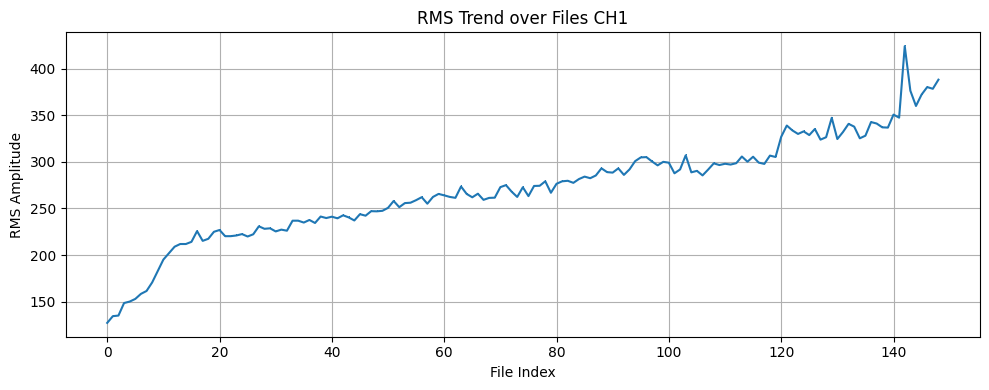

Train_Set/Train2_2_rms
✅ Plot saved to: rms_plot\Train2_rms_CH2.png


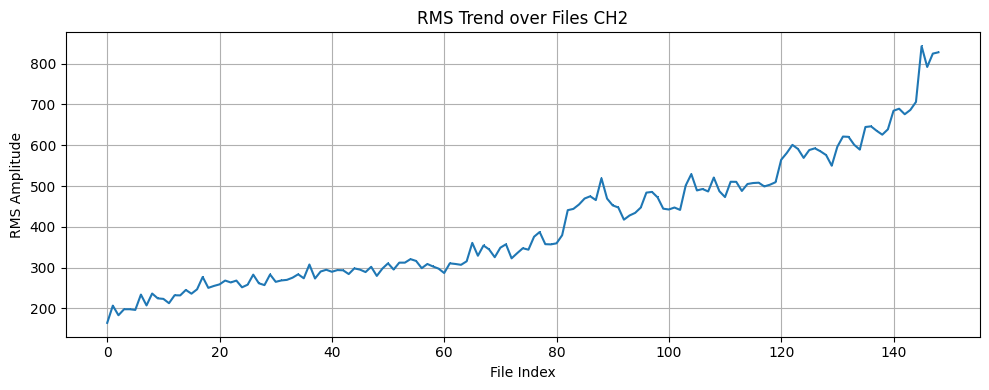

Train_Set/Train2_3_rms
✅ Plot saved to: rms_plot\Train2_rms_CH3.png


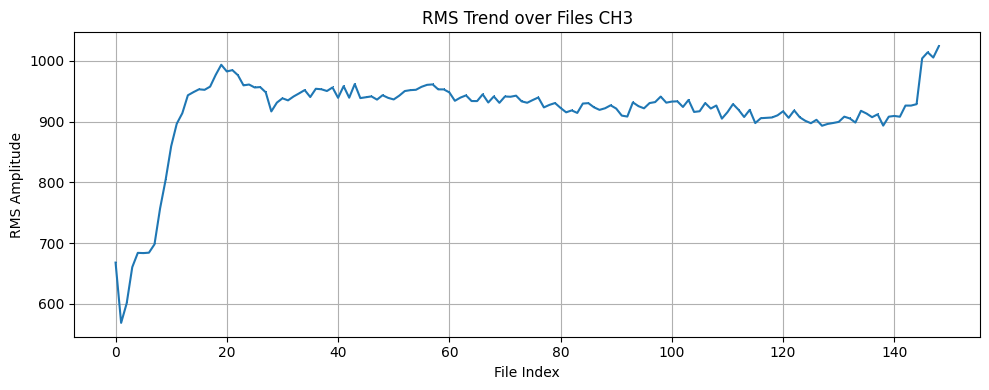

Train_Set/Train2_4_rms
✅ Plot saved to: rms_plot\Train2_rms_CH4.png


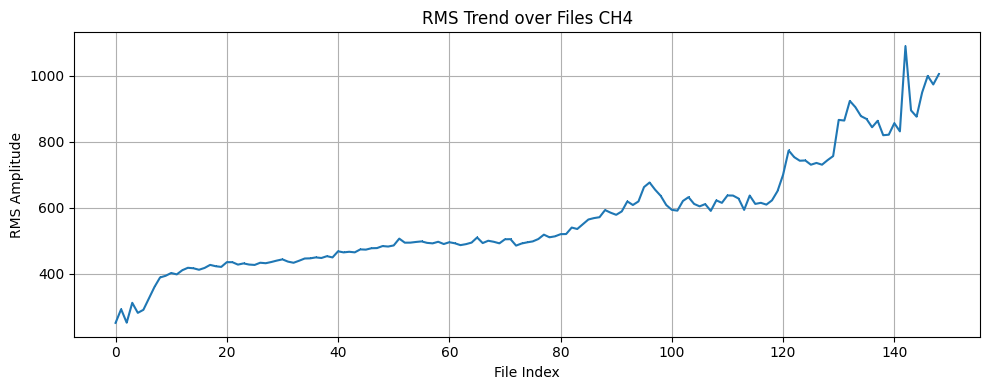

Train_Set/Train3_1_rms
✅ Plot saved to: rms_plot\Train3_rms_CH1.png


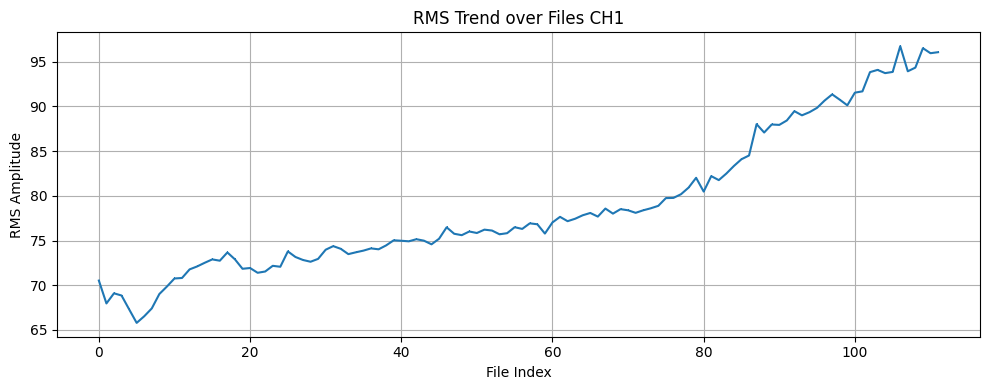

Train_Set/Train3_2_rms
✅ Plot saved to: rms_plot\Train3_rms_CH2.png


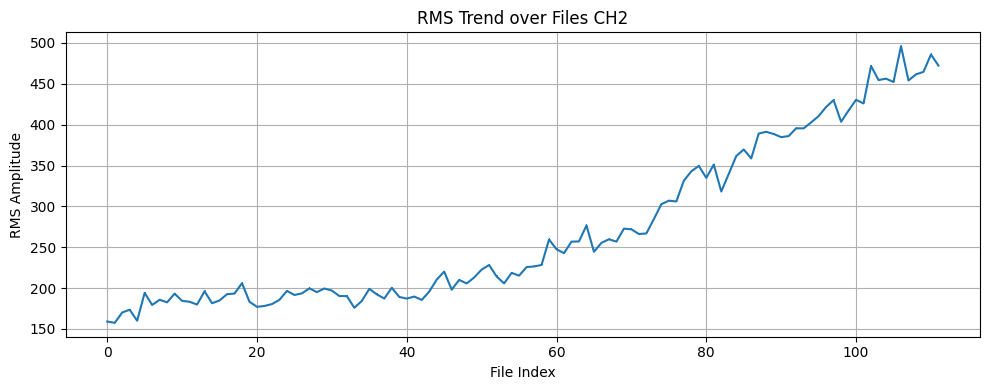

Train_Set/Train3_3_rms
✅ Plot saved to: rms_plot\Train3_rms_CH3.png


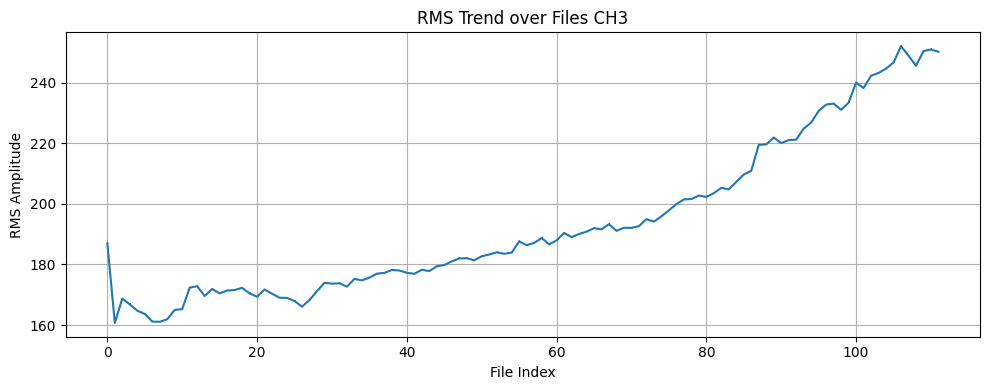

Train_Set/Train3_4_rms
✅ Plot saved to: rms_plot\Train3_rms_CH4.png


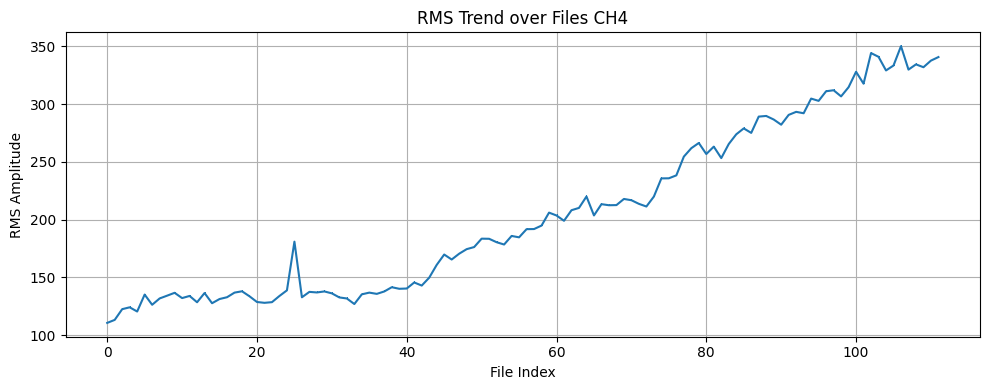

Train_Set/Train4_1_rms
✅ Plot saved to: rms_plot\Train4_rms_CH1.png


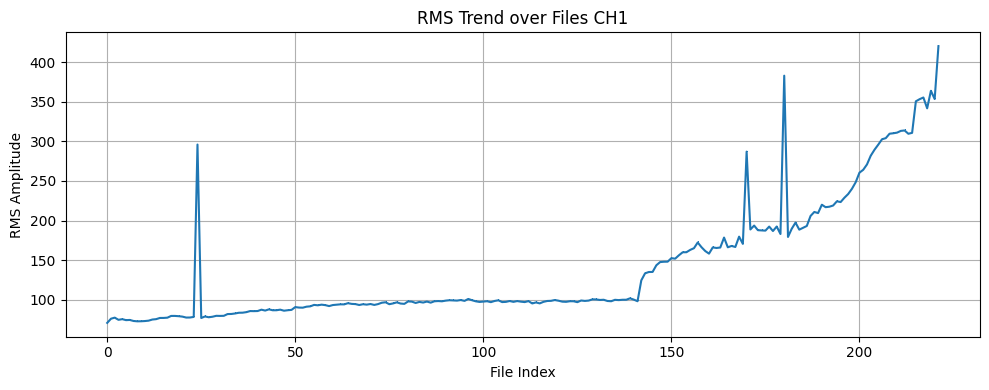

Train_Set/Train4_2_rms
✅ Plot saved to: rms_plot\Train4_rms_CH2.png


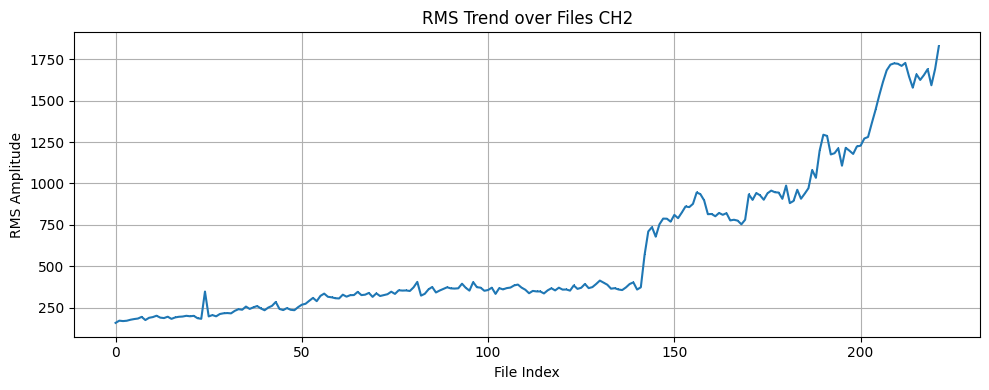

Train_Set/Train4_3_rms
✅ Plot saved to: rms_plot\Train4_rms_CH3.png


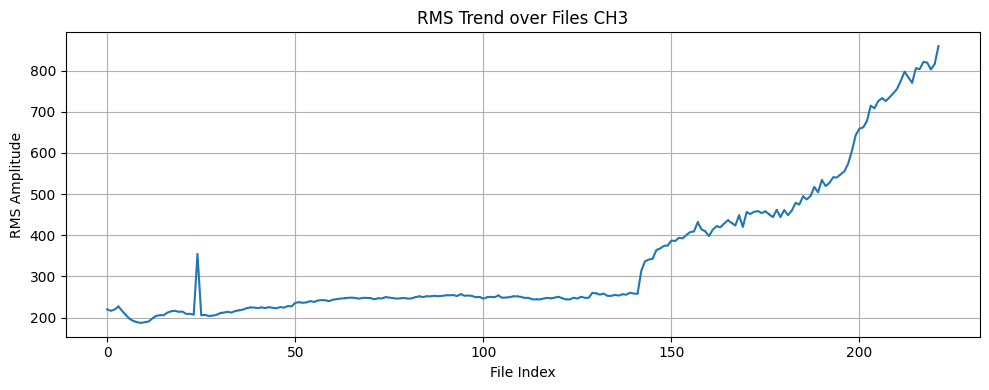

Train_Set/Train4_4_rms
✅ Plot saved to: rms_plot\Train4_rms_CH4.png


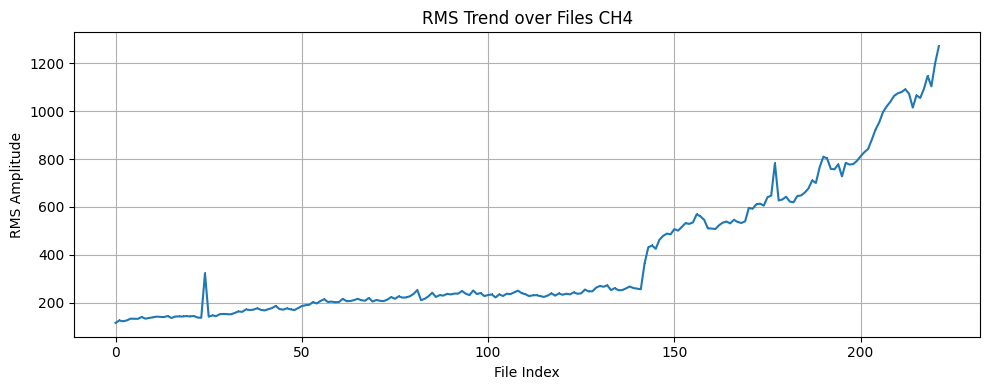

Train_Set/Train5_1_rms
✅ Plot saved to: rms_plot\Train5_rms_CH1.png


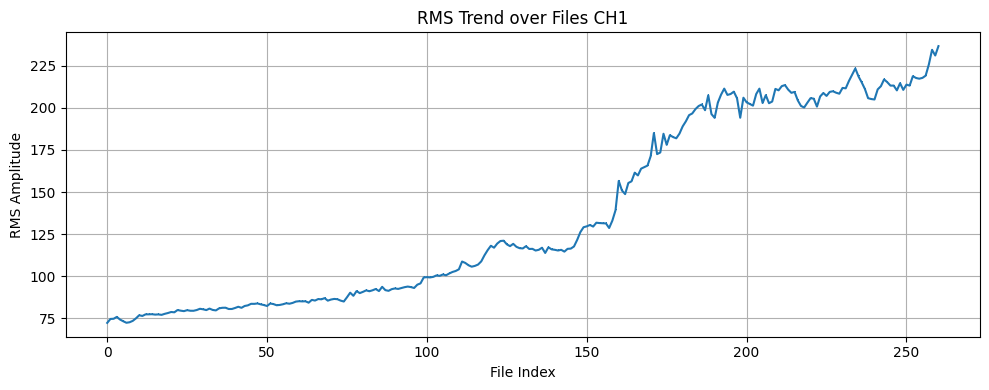

Train_Set/Train5_2_rms
✅ Plot saved to: rms_plot\Train5_rms_CH2.png


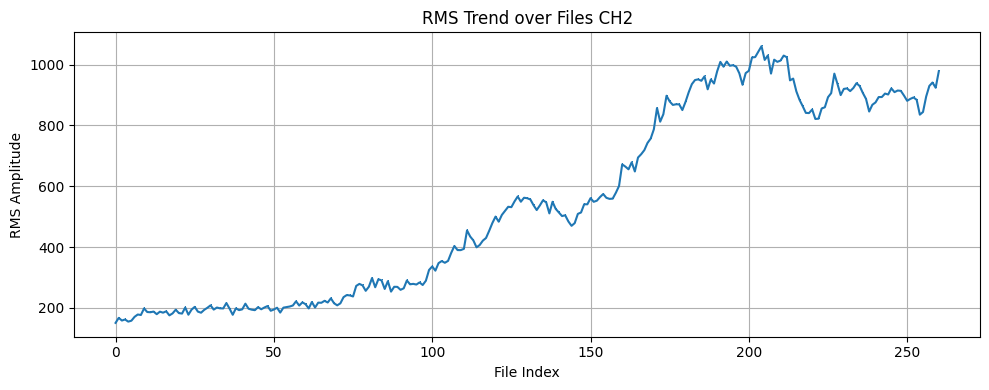

Train_Set/Train5_3_rms
✅ Plot saved to: rms_plot\Train5_rms_CH3.png


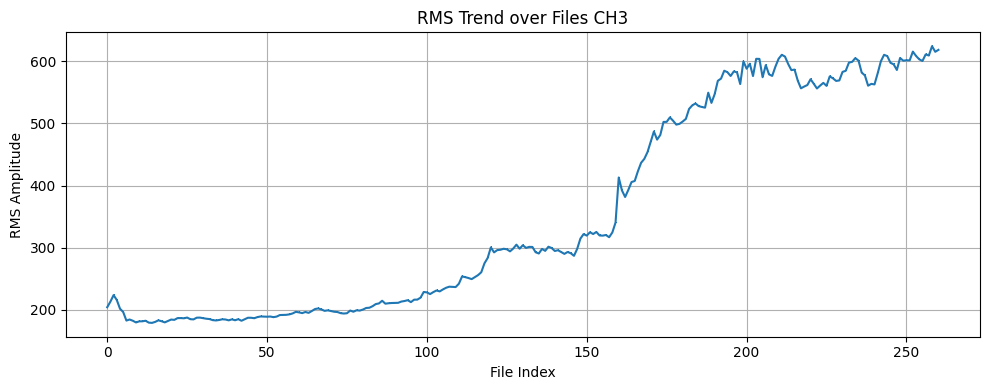

Train_Set/Train5_4_rms
✅ Plot saved to: rms_plot\Train5_rms_CH4.png


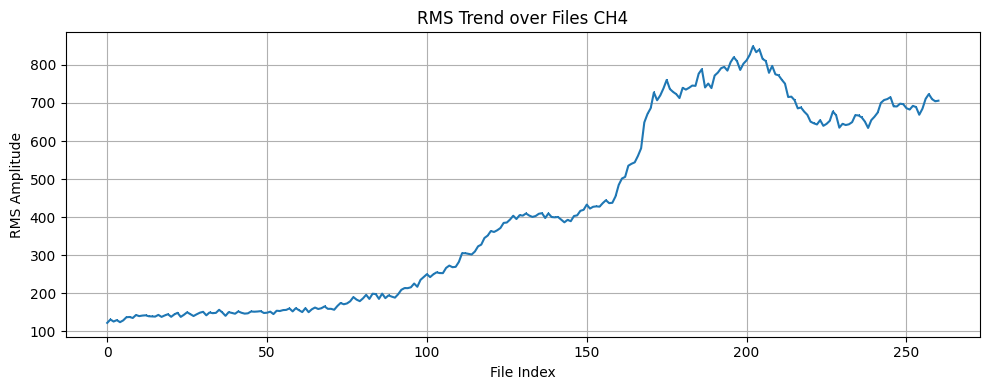

Train_Set/Train6_1_rms
✅ Plot saved to: rms_plot\Train6_rms_CH1.png


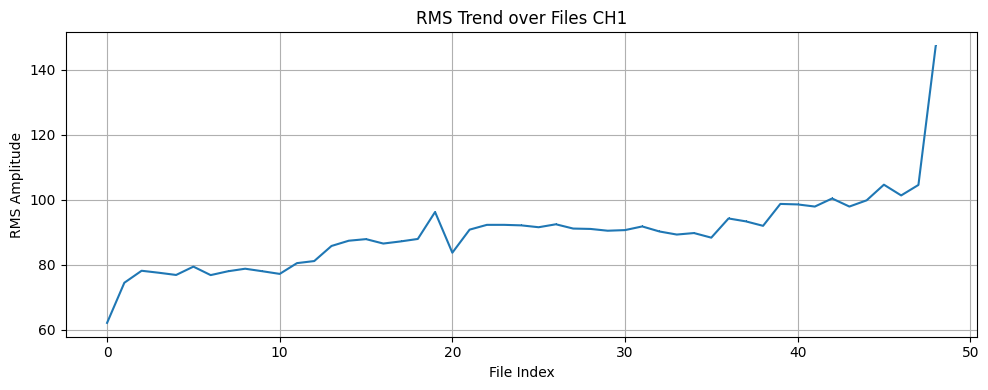

Train_Set/Train6_2_rms
✅ Plot saved to: rms_plot\Train6_rms_CH2.png


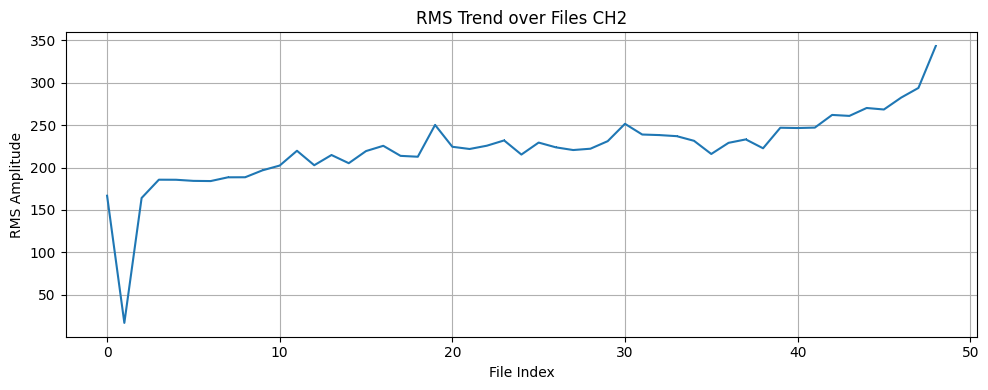

Train_Set/Train6_3_rms
✅ Plot saved to: rms_plot\Train6_rms_CH3.png


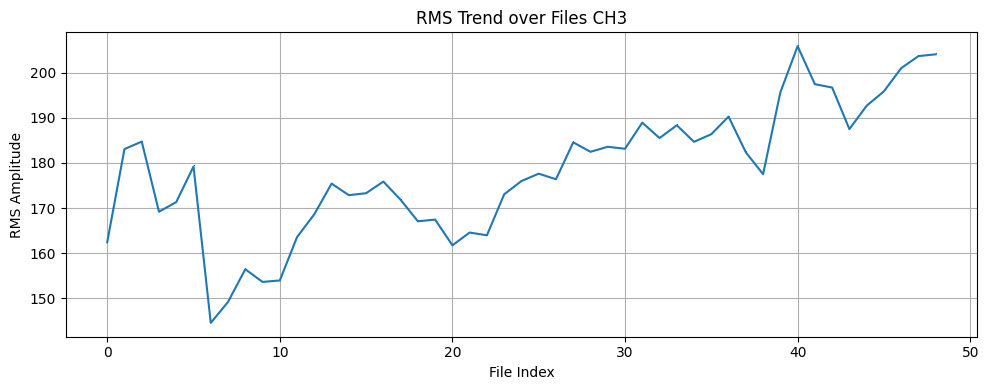

Train_Set/Train6_4_rms
✅ Plot saved to: rms_plot\Train6_rms_CH4.png


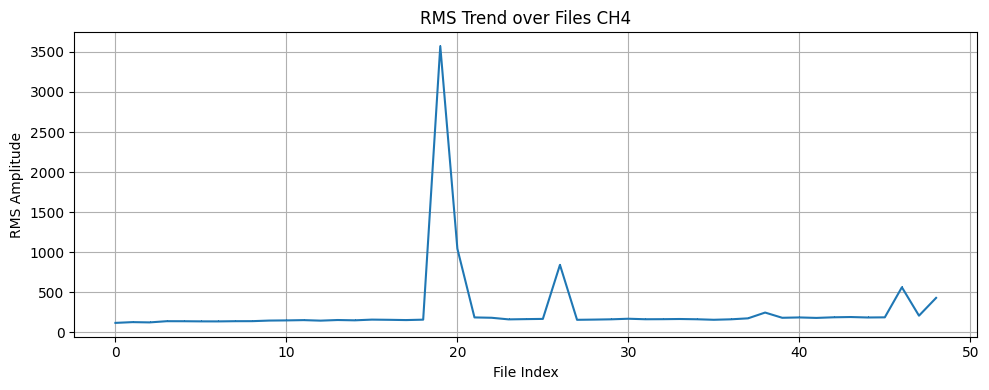

Train_Set/Train7_1_rms
✅ Plot saved to: rms_plot\Train7_rms_CH1.png


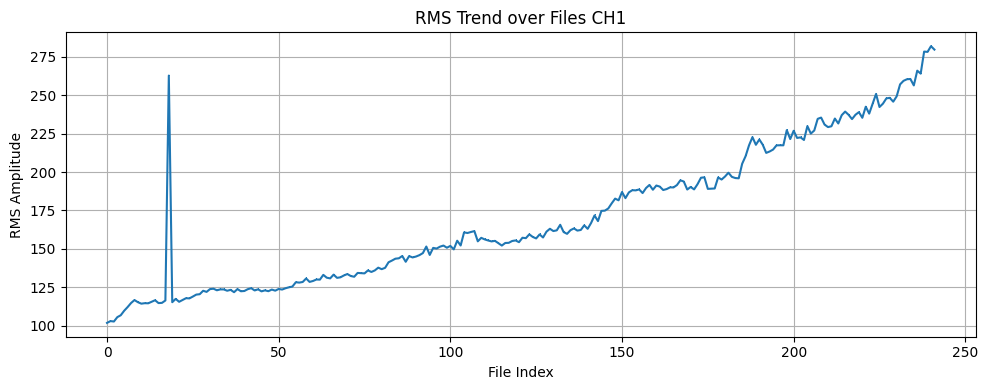

Train_Set/Train7_2_rms
✅ Plot saved to: rms_plot\Train7_rms_CH2.png


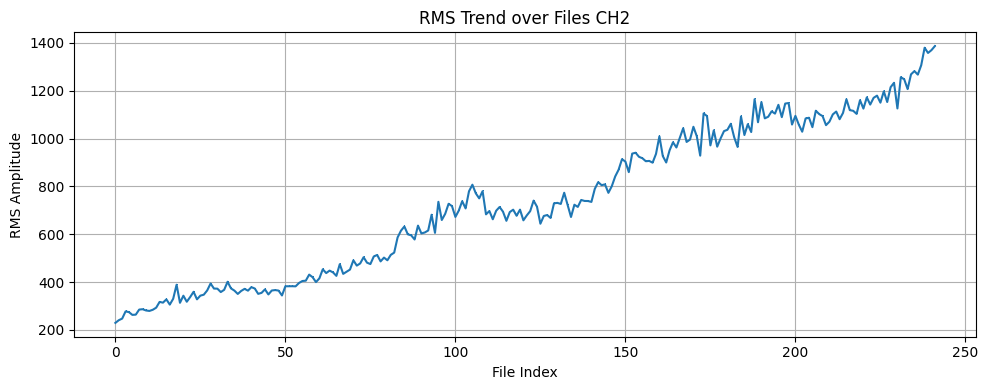

Train_Set/Train7_3_rms
✅ Plot saved to: rms_plot\Train7_rms_CH3.png


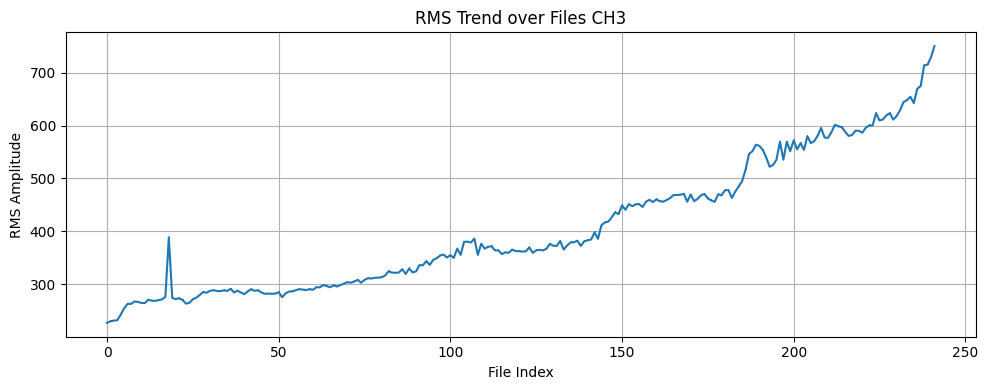

Train_Set/Train7_4_rms
✅ Plot saved to: rms_plot\Train7_rms_CH4.png


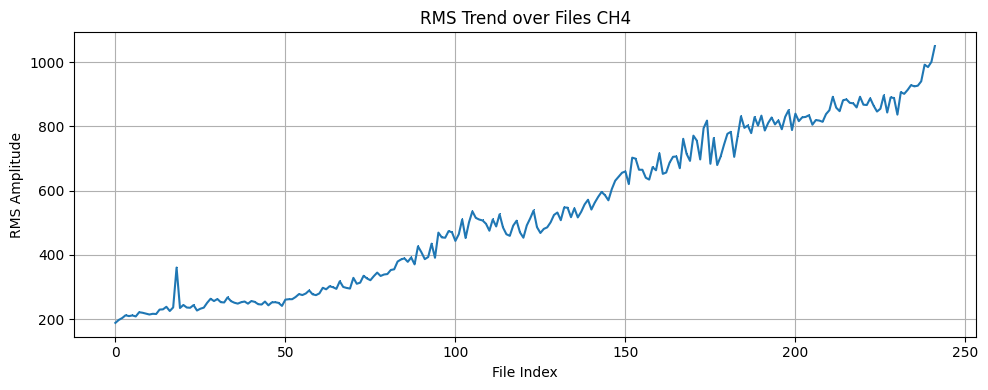

Train_Set/Train8_1_rms
✅ Plot saved to: rms_plot\Train8_rms_CH1.png


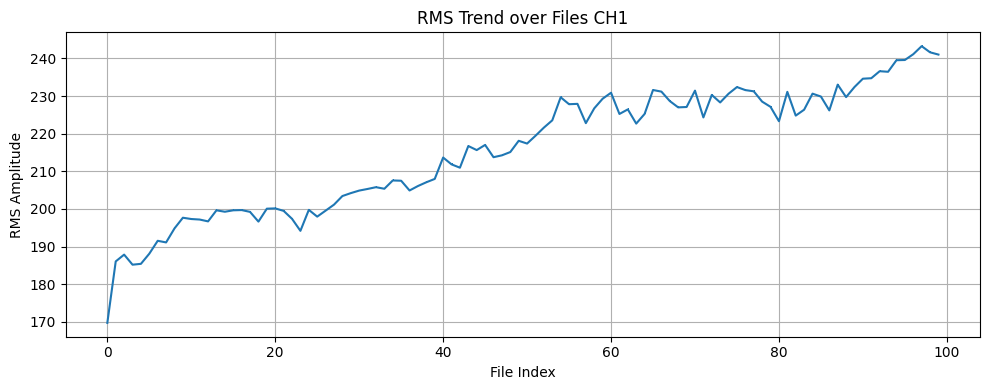

Train_Set/Train8_2_rms
✅ Plot saved to: rms_plot\Train8_rms_CH2.png


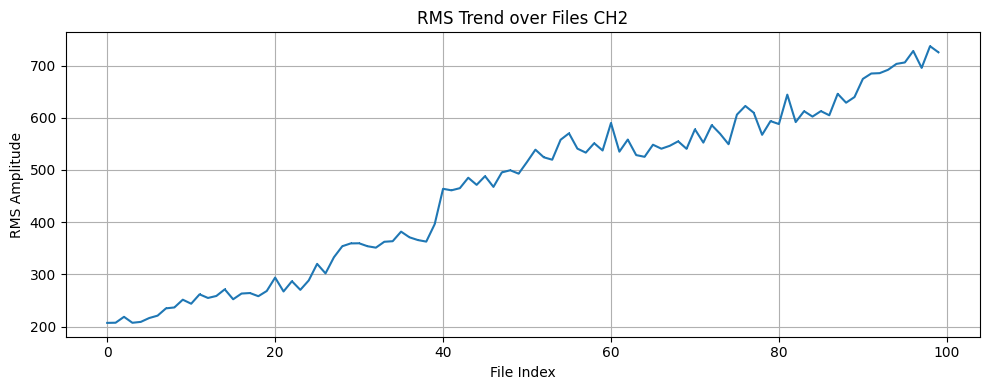

Train_Set/Train8_3_rms
✅ Plot saved to: rms_plot\Train8_rms_CH3.png


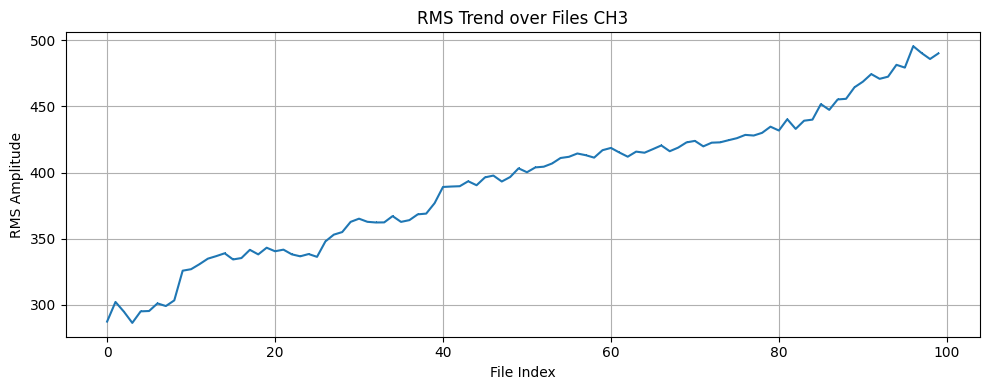

Train_Set/Train8_4_rms
✅ Plot saved to: rms_plot\Train8_rms_CH4.png


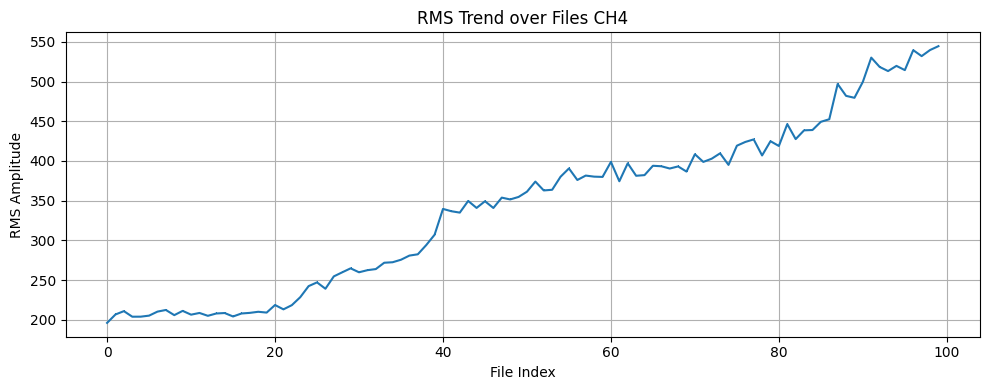

In [75]:
for Nset in range(1, 9):
    for ch in range(1, 5):
        print(f"Train_Set/Train{Nset}_{ch}_rms")
        visualize_folder_rms_surface(f"Train_Set/Train{Nset}", ch, "rms_plot", fs=25600)

Train_Set/Train1_1_fft


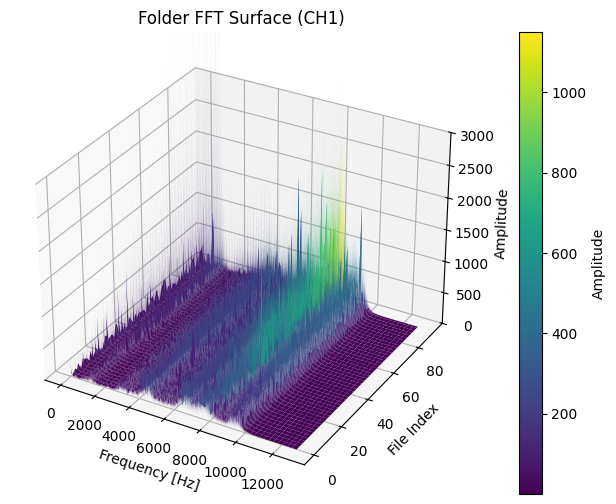

Train_Set/Train1_2_fft


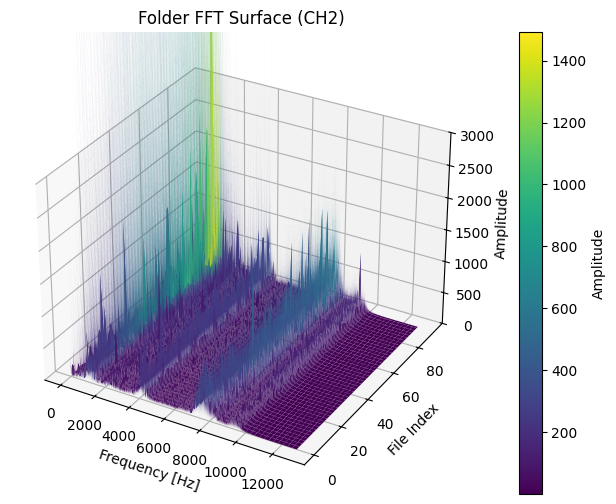

Train_Set/Train1_3_fft


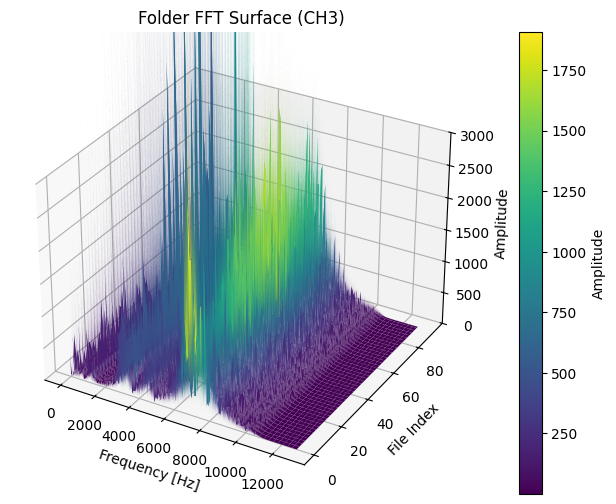

Train_Set/Train1_4_fft


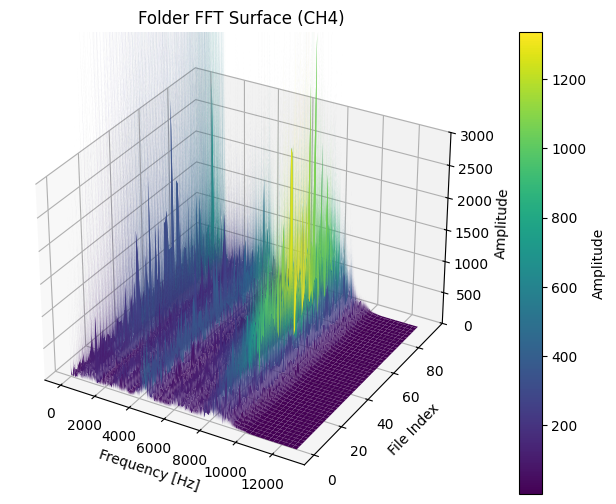

Train_Set/Train2_1_fft


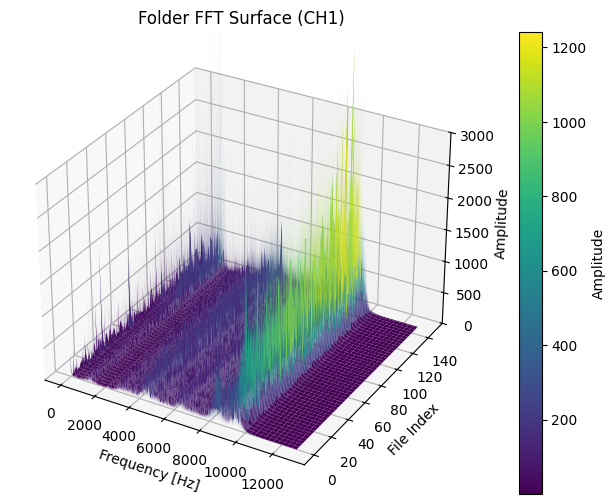

Train_Set/Train2_2_fft


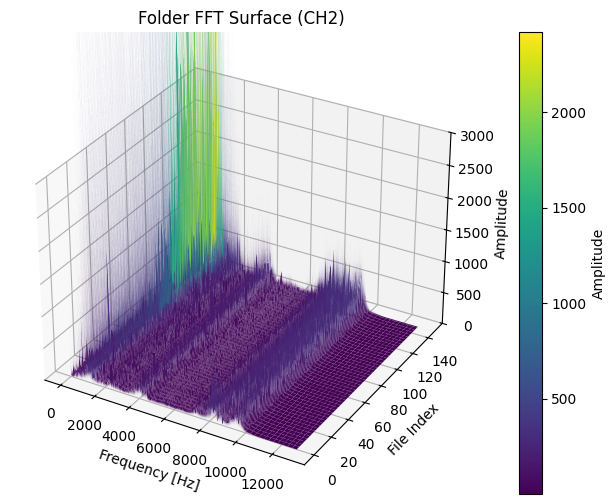

Train_Set/Train2_3_fft


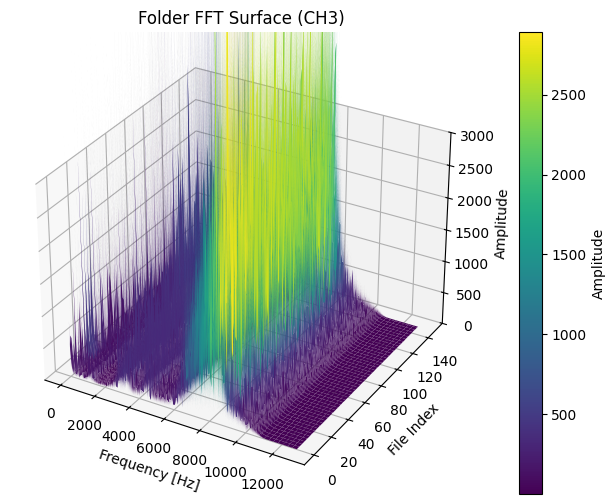

Train_Set/Train2_4_fft


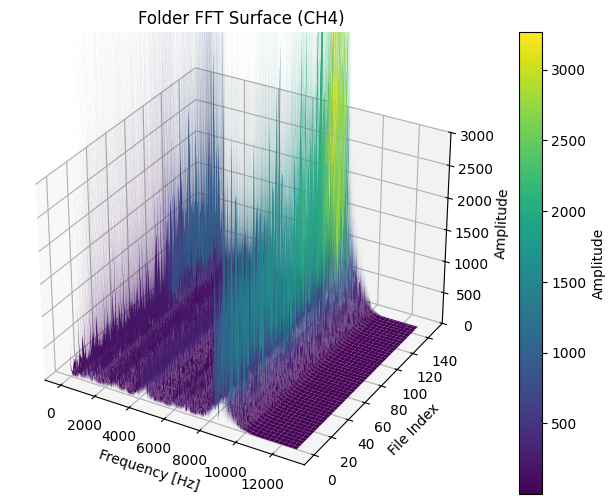

Train_Set/Train3_1_fft


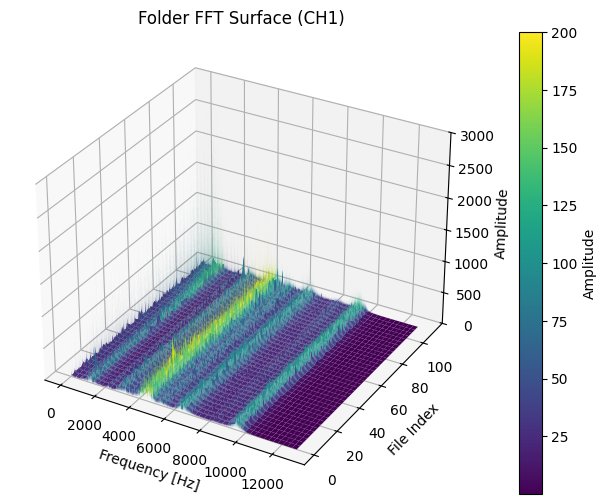

Train_Set/Train3_2_fft


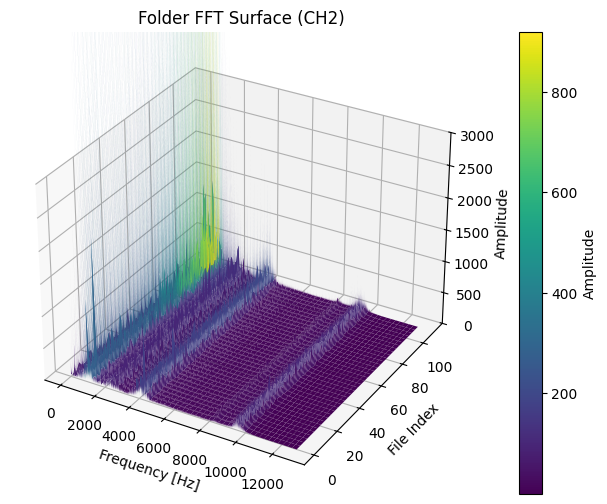

Train_Set/Train3_3_fft


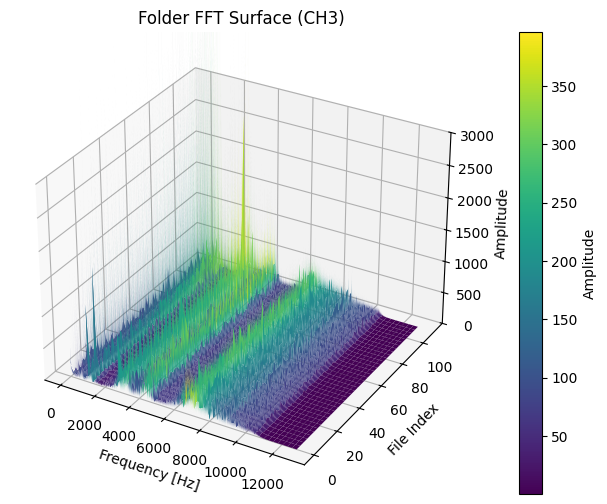

Train_Set/Train3_4_fft


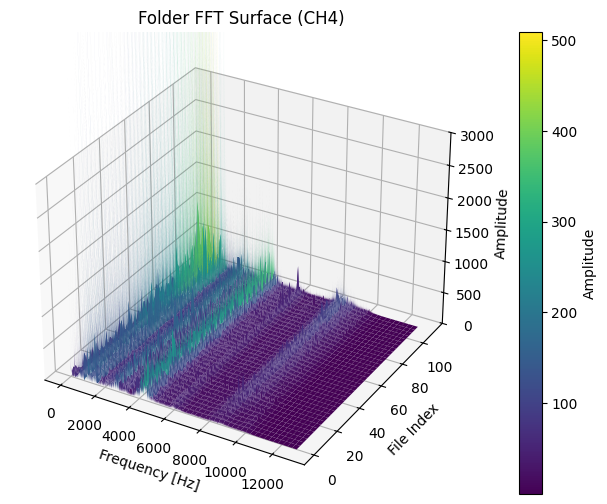

Train_Set/Train4_1_fft


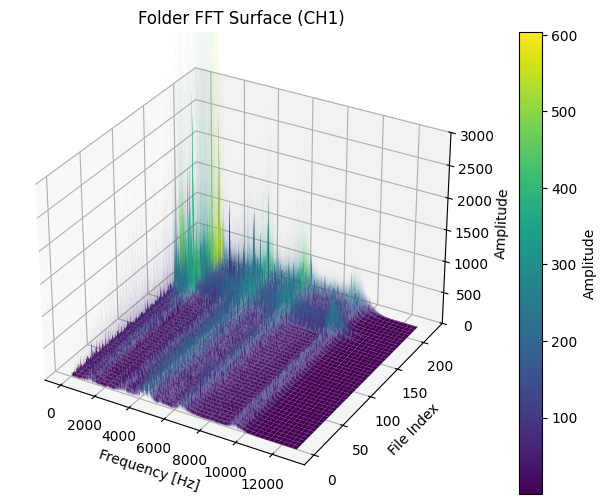

Train_Set/Train4_2_fft


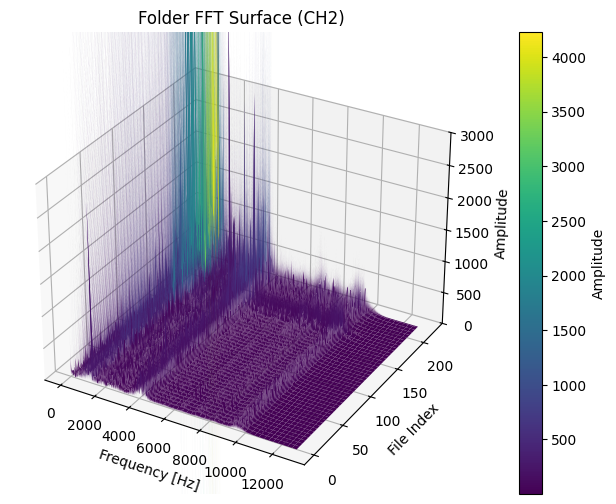

Train_Set/Train4_3_fft


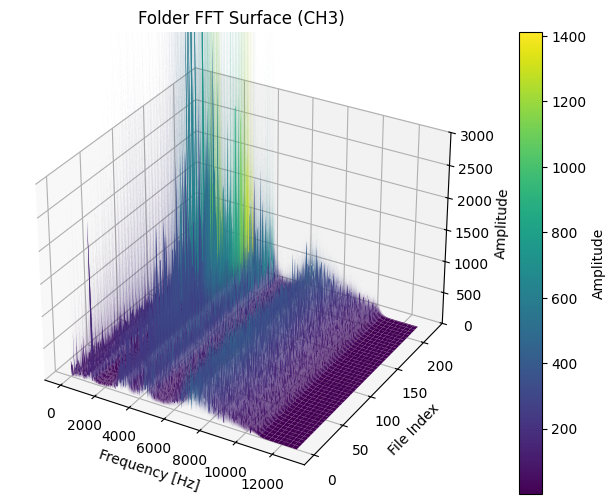

Train_Set/Train4_4_fft


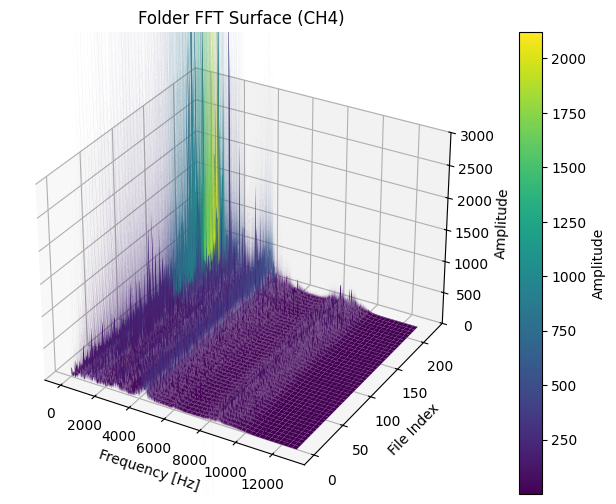

Train_Set/Train5_1_fft


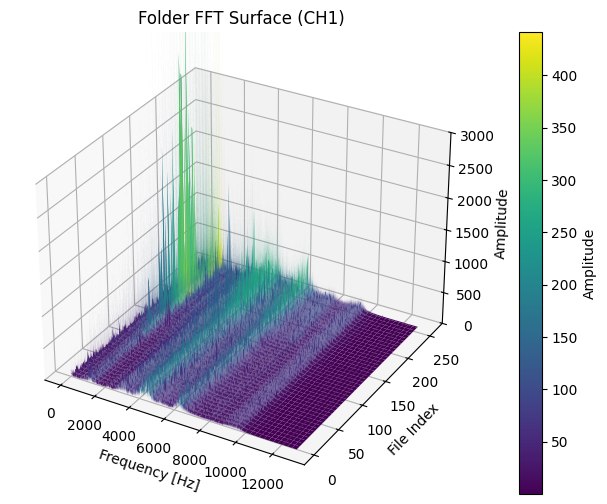

Train_Set/Train5_2_fft


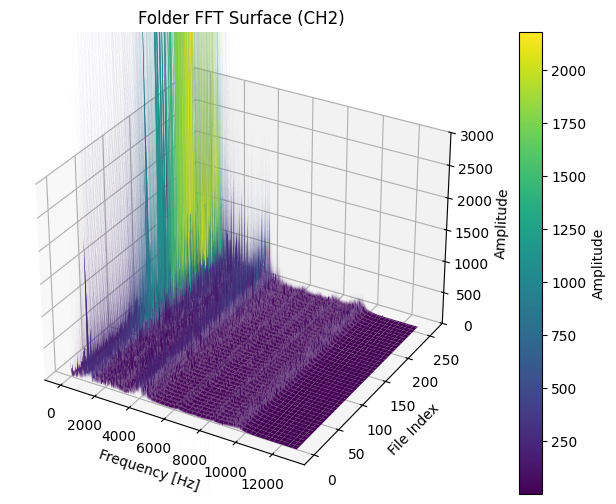

Train_Set/Train5_3_fft


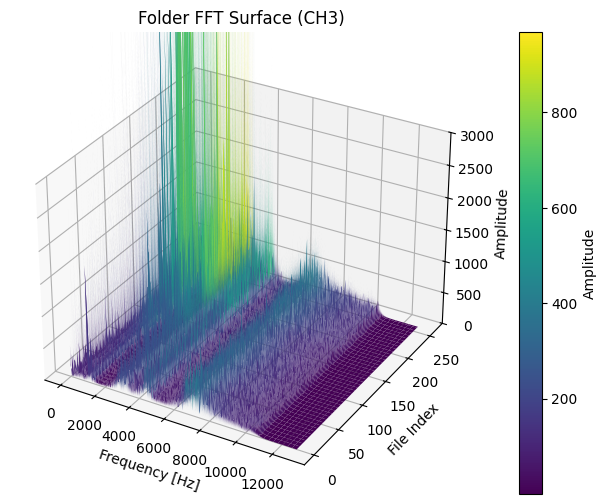

Train_Set/Train5_4_fft


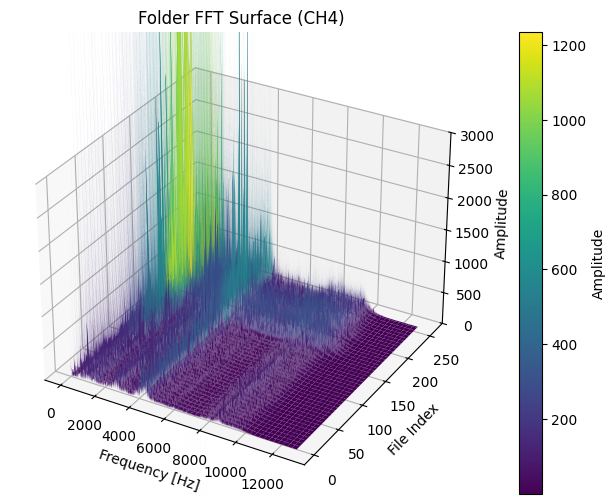

Train_Set/Train6_1_fft


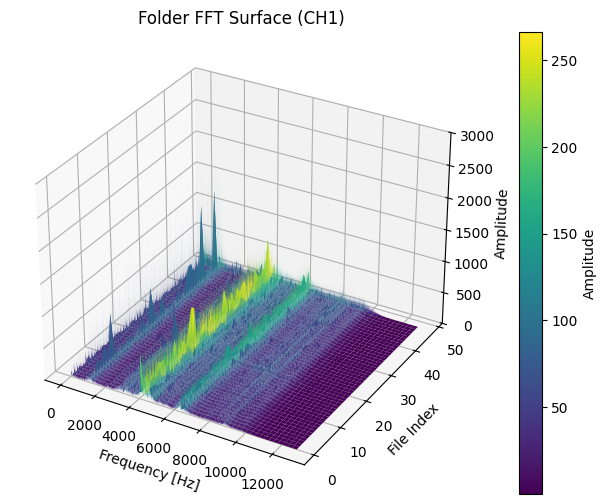

Train_Set/Train6_2_fft


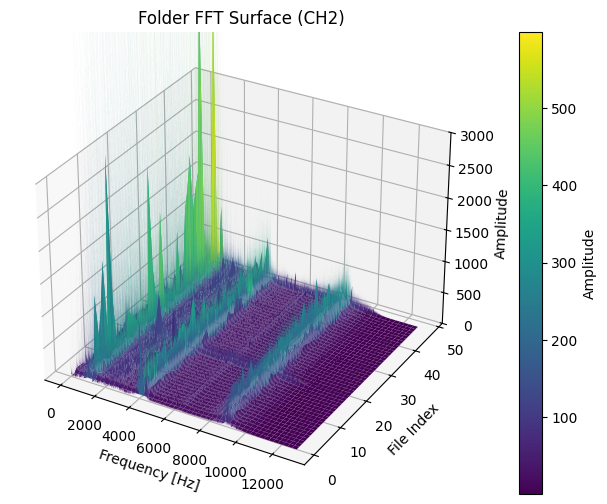

Train_Set/Train6_3_fft


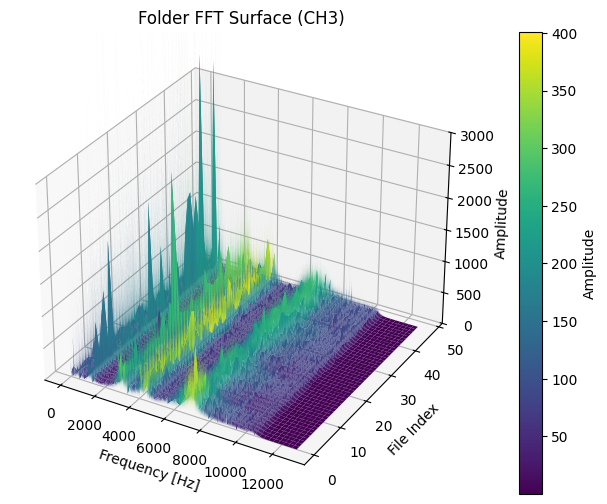

Train_Set/Train6_4_fft


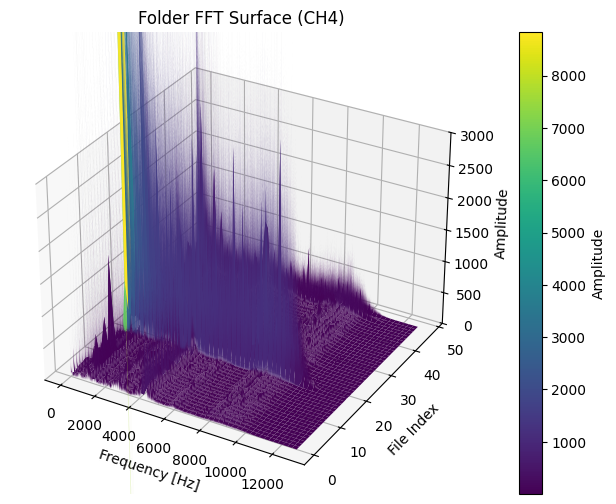

Train_Set/Train7_1_fft


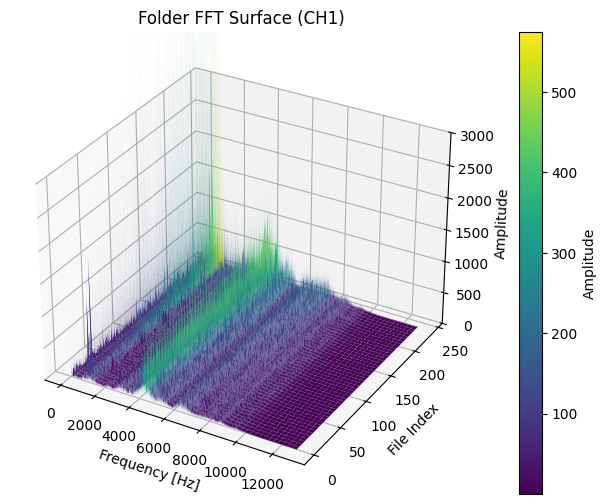

Train_Set/Train7_2_fft


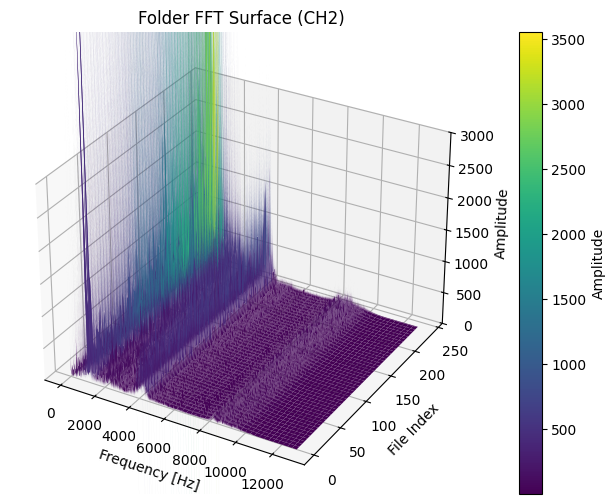

Train_Set/Train7_3_fft


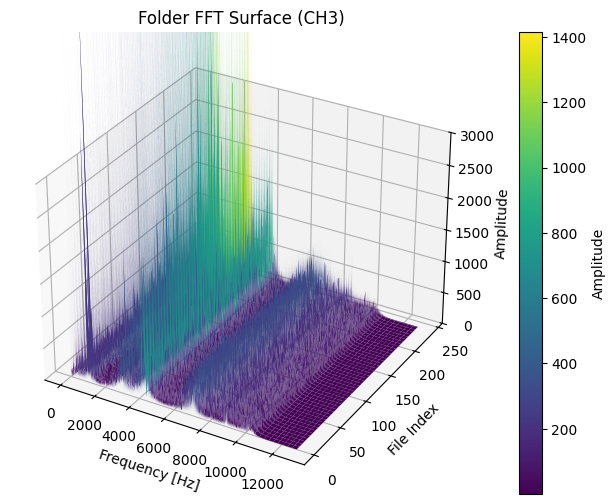

Train_Set/Train7_4_fft


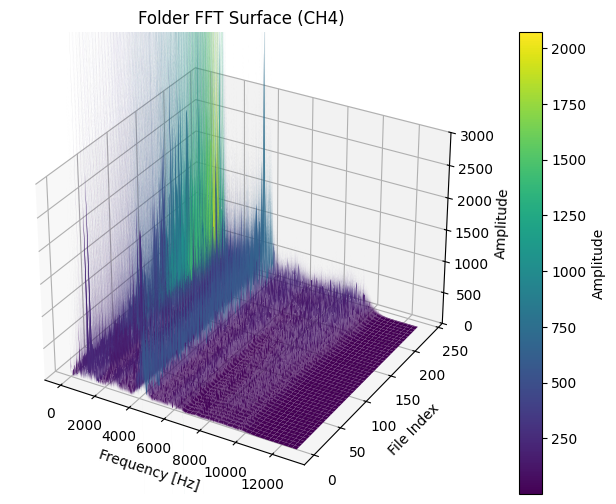

Train_Set/Train8_1_fft


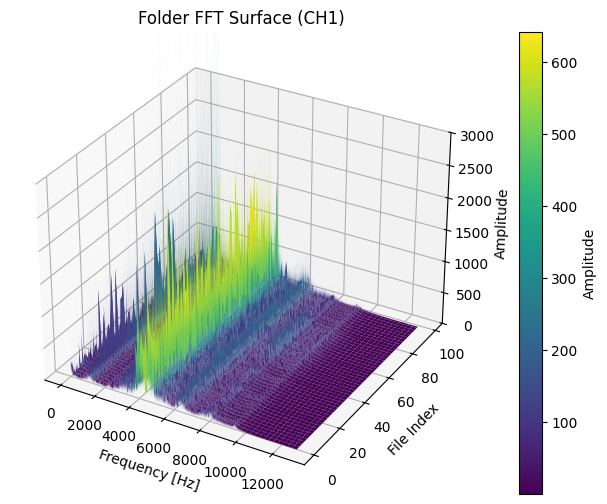

Train_Set/Train8_2_fft


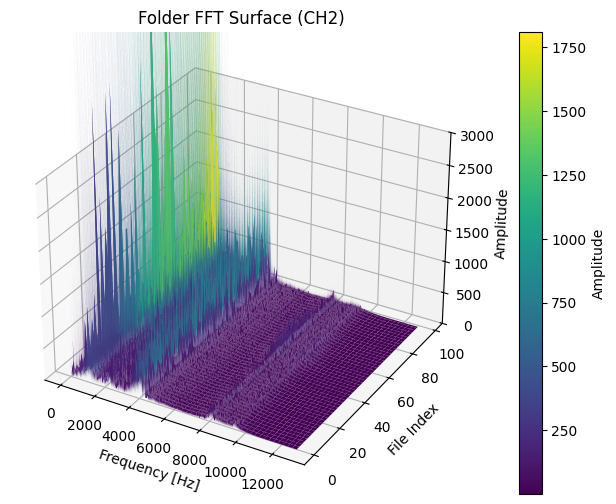

Train_Set/Train8_3_fft


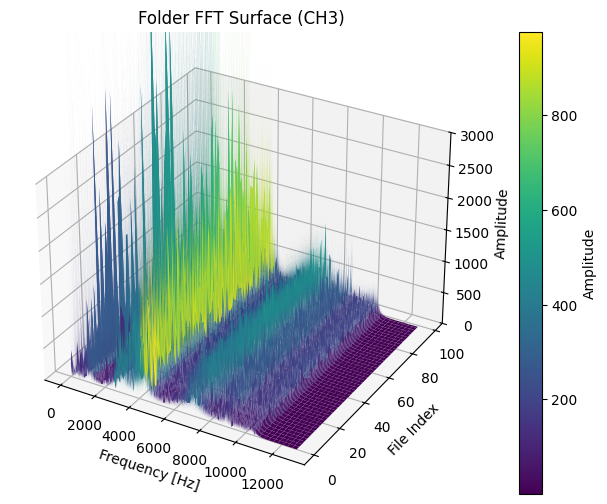

Train_Set/Train8_4_fft


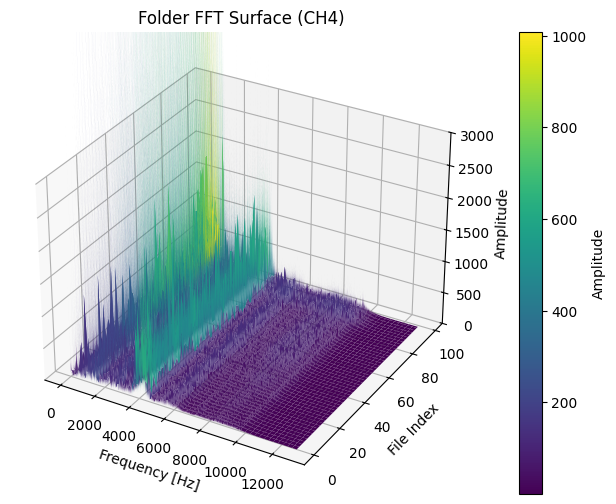

In [62]:
for Nset in range(1, 9):
    for ch in range(1, 5):
        print(f"Train_Set/Train{Nset}_{ch}_fft")
        visualize_folder_fft_surface(f"Train_Set/Train{Nset}", ch, rpm=1000)

In [ ]:
def visualize_folder_order_surface(folder_path, ch, rpm, fs=25600, max_order=10):
    
    file_list = sorted(glob(f"{folder_path}/*.tdms"))
    n_files = len(file_list)
    if n_files == 0:
        raise FileNotFoundError(f"No .tdms files in {folder_path}")
    
    spectra = []
    for path in file_list:
        vib_data, _ = load_tdms_file(path)
        sig = vib_data[f"CH{ch}"]
        filt = bandpass_filter(sig, fs=fs)
        orders, spec = compute_order_spectrum(filt, fs=fs, rpm=rpm)
        mask = (orders >= 0) & (orders <= max_order)
        spectra.append(spec[mask])

    Z = np.vstack(spectra)
    X, Y = np.meshgrid(orders[mask], np.arange(n_files))

    fig = plt.figure(figsize=(12, 6))
    ax = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(X, Y, Z, cmap='viridis', linewidth=0, antialiased=True)

    ax.set_xlabel("Order (x)")
    ax.set_ylabel("File Index")
    ax.set_zlabel("Amplitude")
    ax.set_title(f"Folder Order Freq Surface (CH{ch}) @ {rpm} RPM")
    ax.set_zlim(0, np.max(Z))

    fig.colorbar(surf, ax=ax, label="Amplitude")
    plt.tight_layout()
    plt.show()

def visualize_folder_harmonic_surface(folder_path, ch, rpm=1000, fs=25600, harmonics=10, points_per_harmonic=30, log_scale=True, min_max=False):
    file_list = sorted(glob(f"{folder_path}/*.tdms"))
    if not file_list:
        raise FileNotFoundError(f"No .tdms files in {folder_path}")
    n_files = len(file_list)

    Z = []
    for path in file_list:
        vib, _ = load_tdms_file(path)
        sig = vib[f"CH{ch}"]
        filt = bandpass_filter(sig, fs=fs)
        orders, spec = compute_order_spectrum(filt, fs=fs, rpm=rpm)
        _, waveform = extract_order_harmonic(
            orders, spec,
            harmonics=harmonics, points_per_harmonic=points_per_harmonic,
            log_scale=log_scale, min_max=min_max
        )
        Z.append(waveform)
    Z = np.vstack(Z)

    detailed_orders = np.concatenate([
        np.linspace(i + 0.5, i + 1.0, points_per_harmonic)
        for i in range(harmonics)
    ])
    X, Y = np.meshgrid(detailed_orders, np.arange(n_files))
    fig = plt.figure(figsize=(12, 6))
    ax  = fig.add_subplot(111, projection='3d')
    surf = ax.plot_surface(X, Y, Z, cmap='viridis', linewidth=0, antialiased=True)

    ax.set_xlabel("Order (×)")
    ax.set_ylabel("File Index")
    ax.set_zlabel("Normalized Amplitude")
    ax.set_title(f"Harmonic Order Spectrum Surface (CH{ch}) @ {rpm} RPM")
    ax.set_zlim(0, 1.0)  # normalized 범위
    fig.colorbar(surf, ax=ax, label="Normalized Amplitude")

    plt.tight_layout()
    plt.show()


Train_Set/Train1_1_order


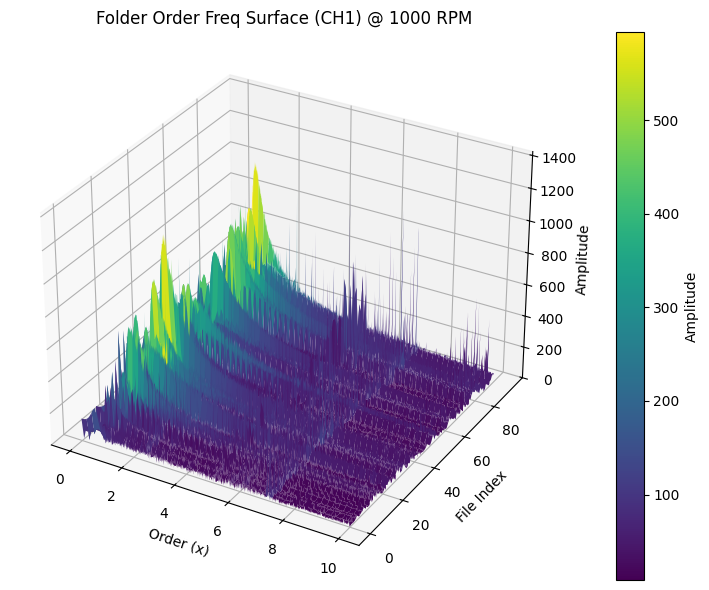

Train_Set/Train1_2_order


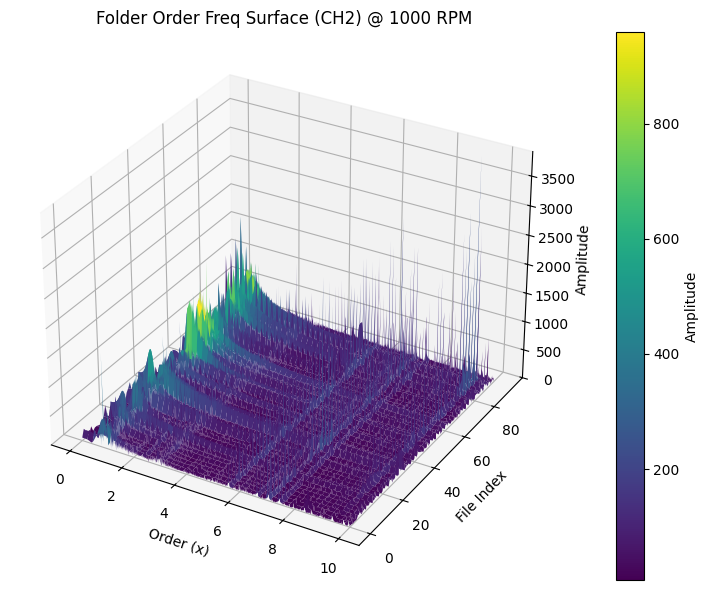

Train_Set/Train1_3_order


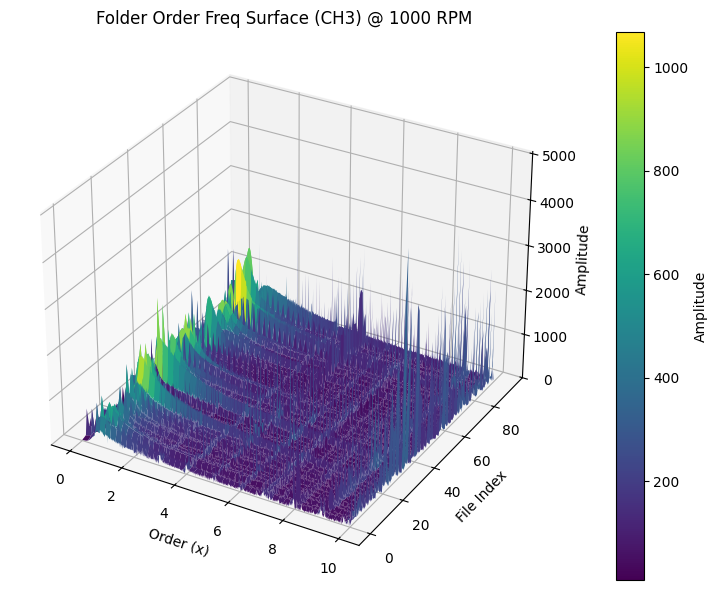

Train_Set/Train1_4_order


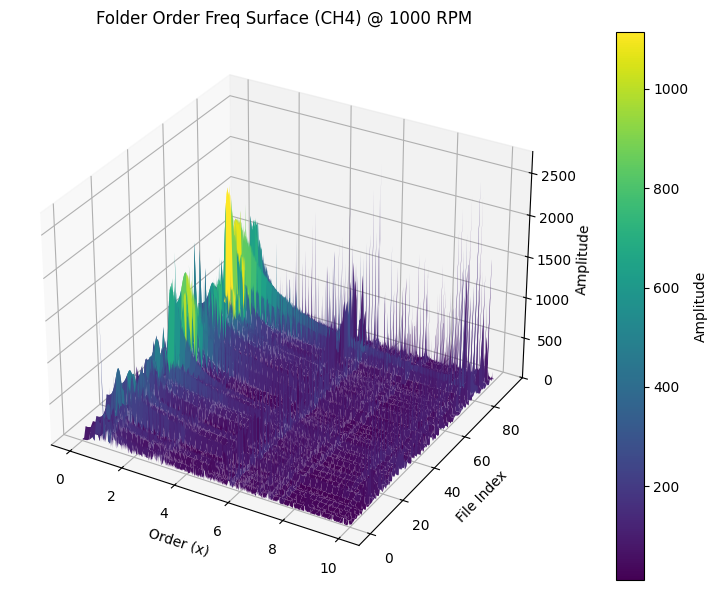

Train_Set/Train2_1_order


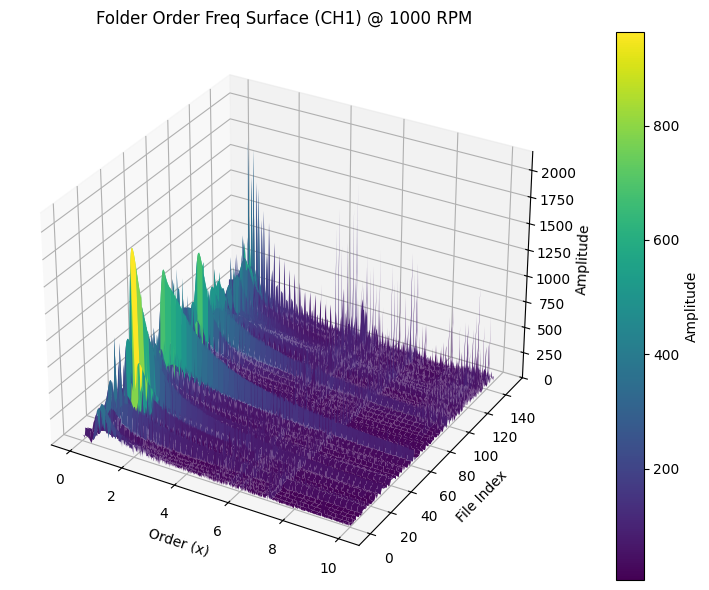

Train_Set/Train2_2_order


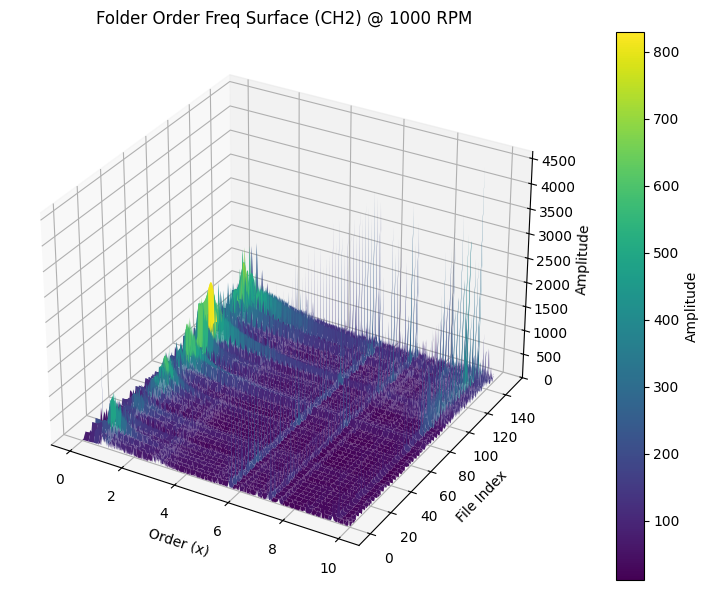

Train_Set/Train2_3_order


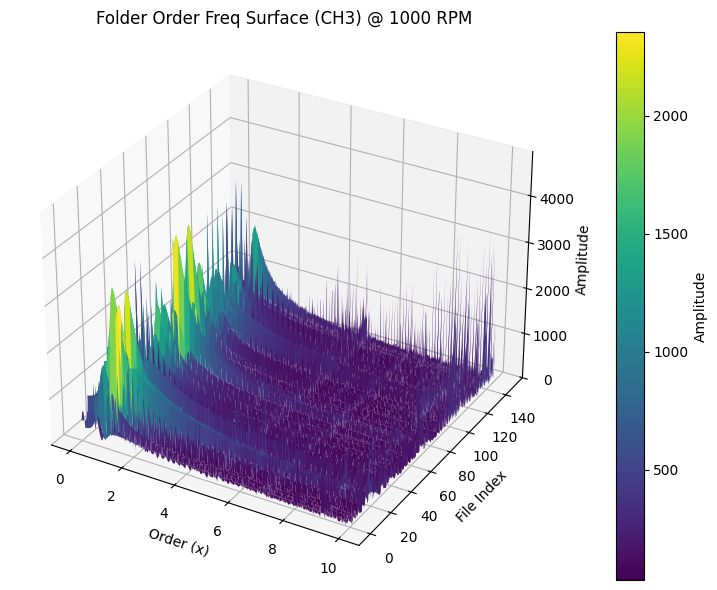

Train_Set/Train2_4_order


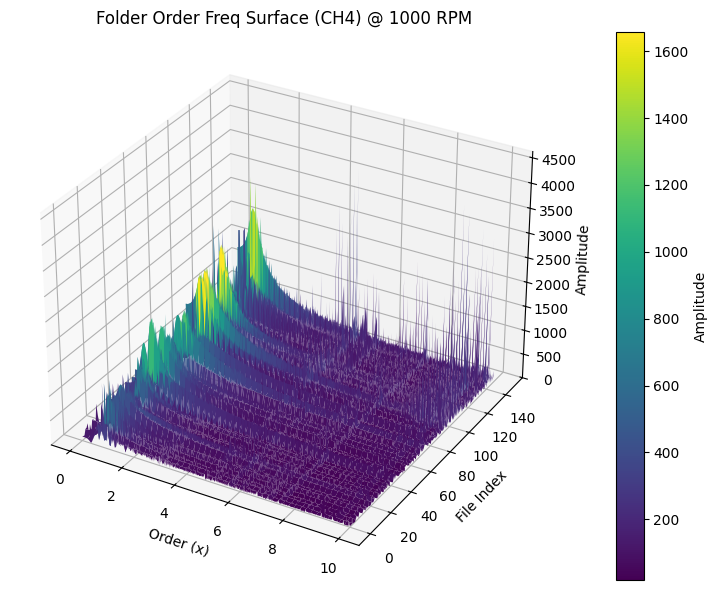

Train_Set/Train3_1_order


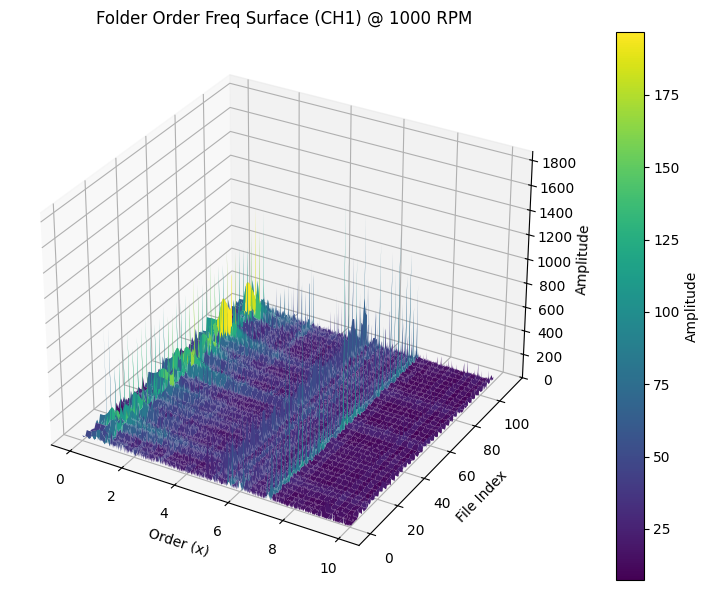

Train_Set/Train3_2_order


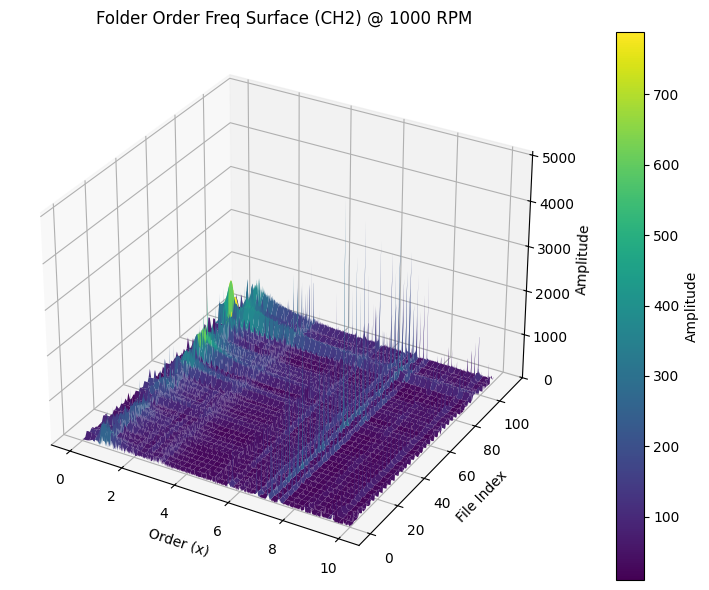

Train_Set/Train3_3_order


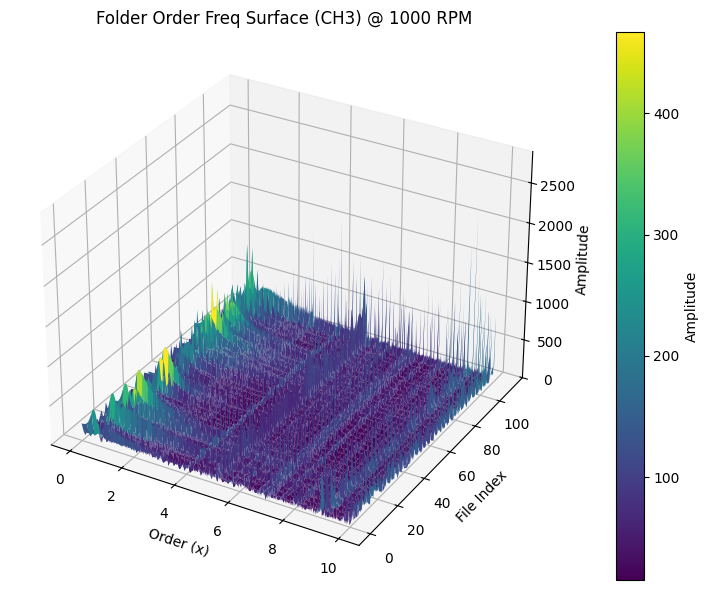

Train_Set/Train3_4_order


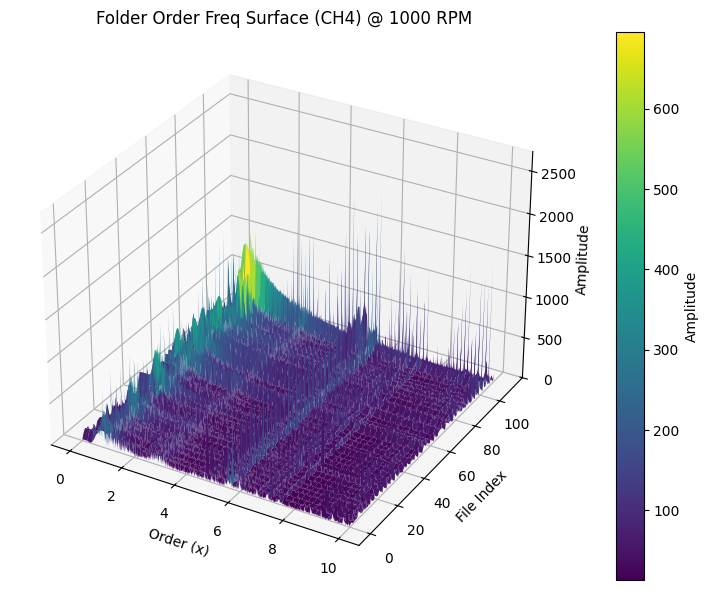

Train_Set/Train4_1_order


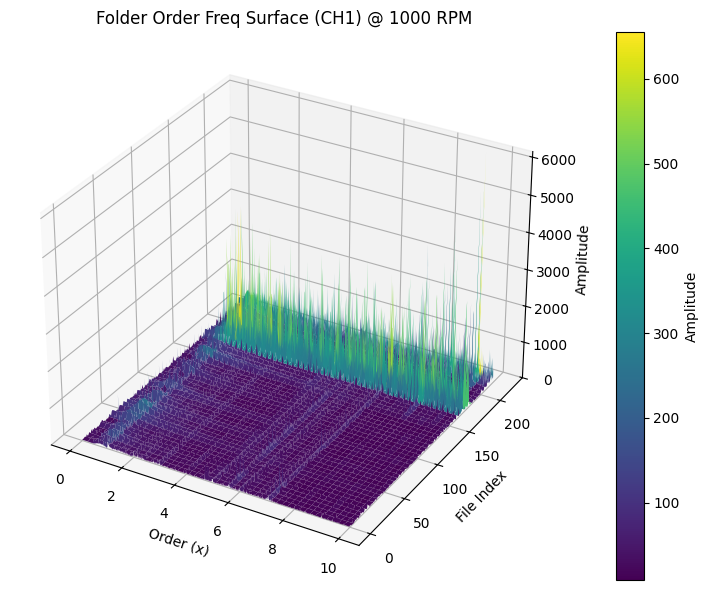

Train_Set/Train4_2_order


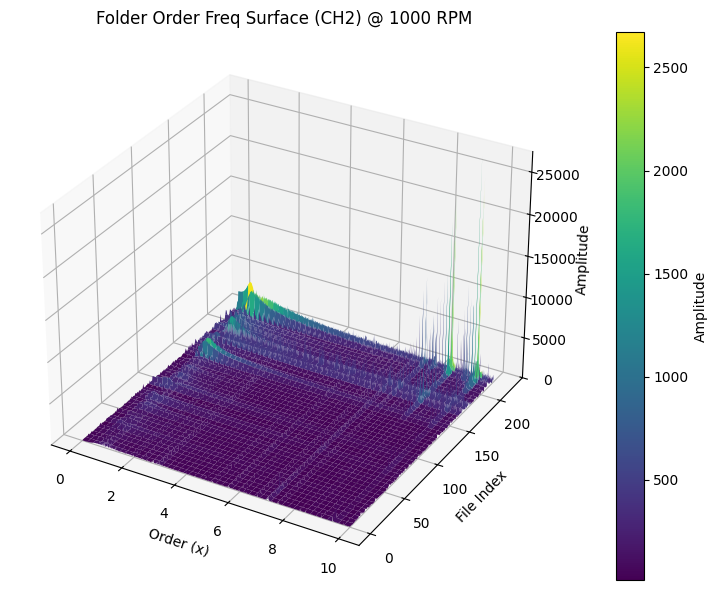

Train_Set/Train4_3_order


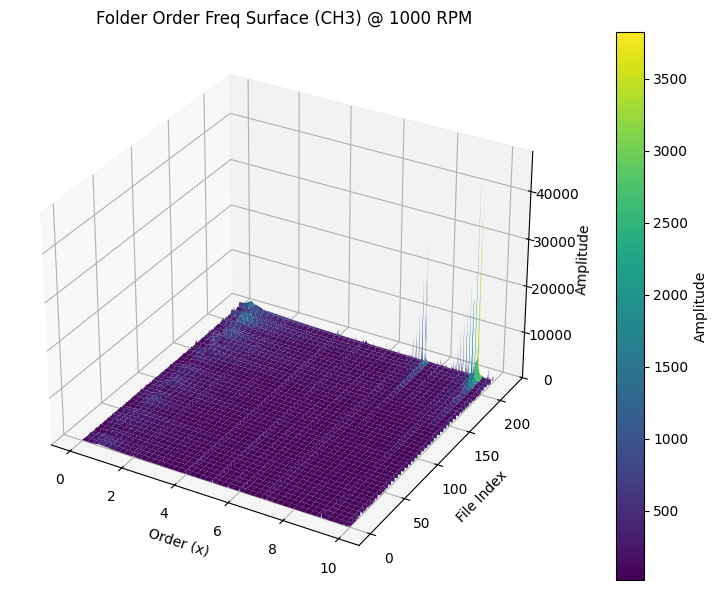

Train_Set/Train4_4_order


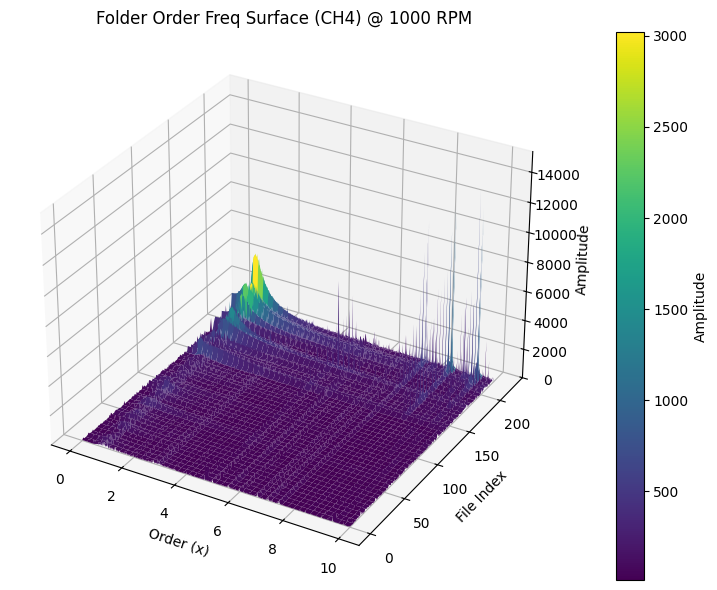

Train_Set/Train5_1_order


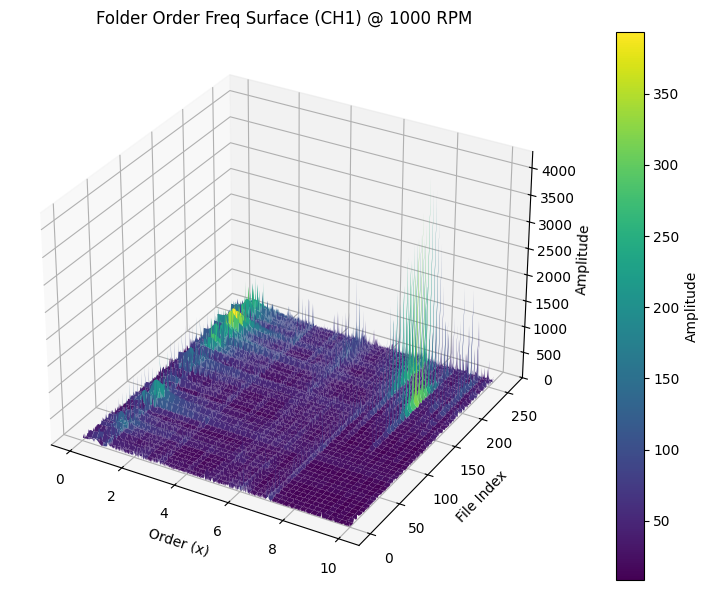

Train_Set/Train5_2_order


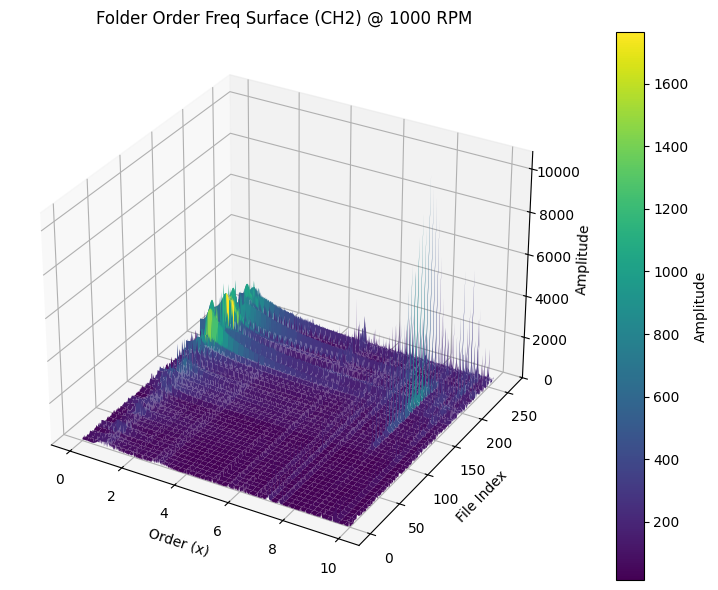

Train_Set/Train5_3_order


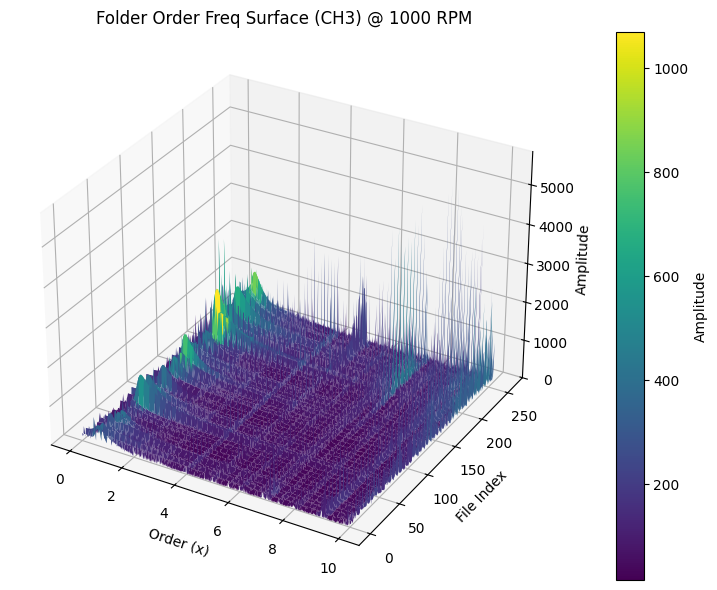

Train_Set/Train5_4_order


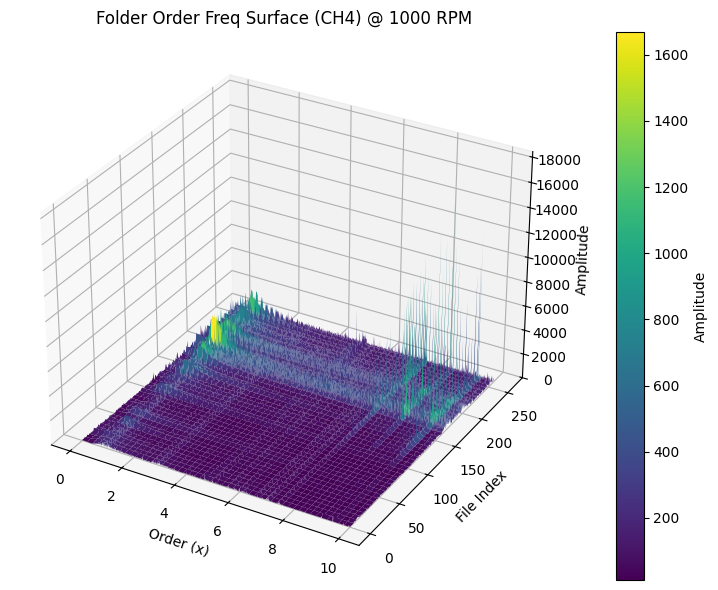

Train_Set/Train6_1_order


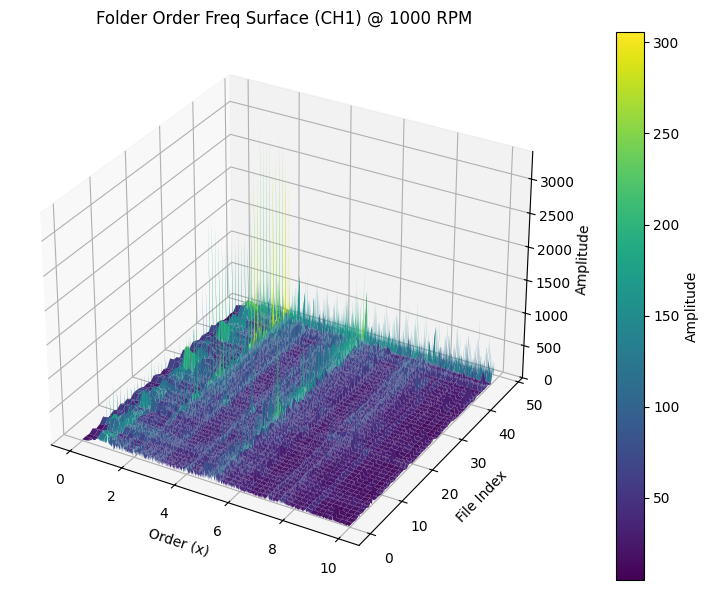

Train_Set/Train6_2_order


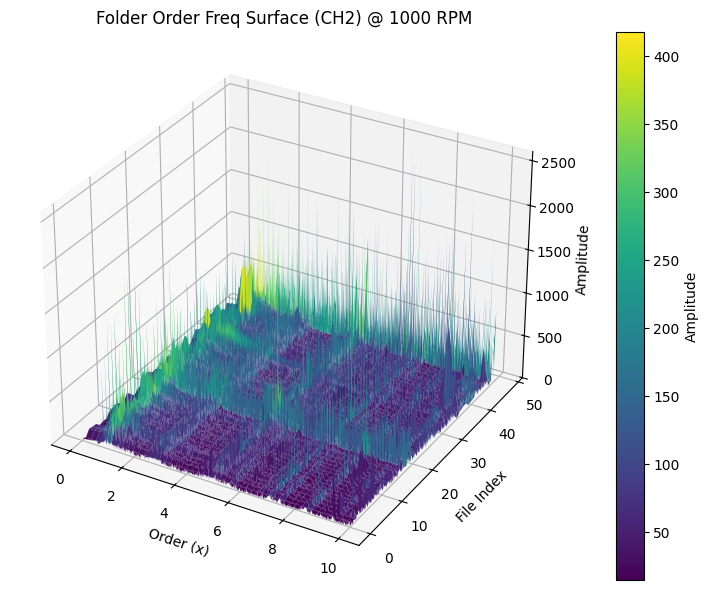

Train_Set/Train6_3_order


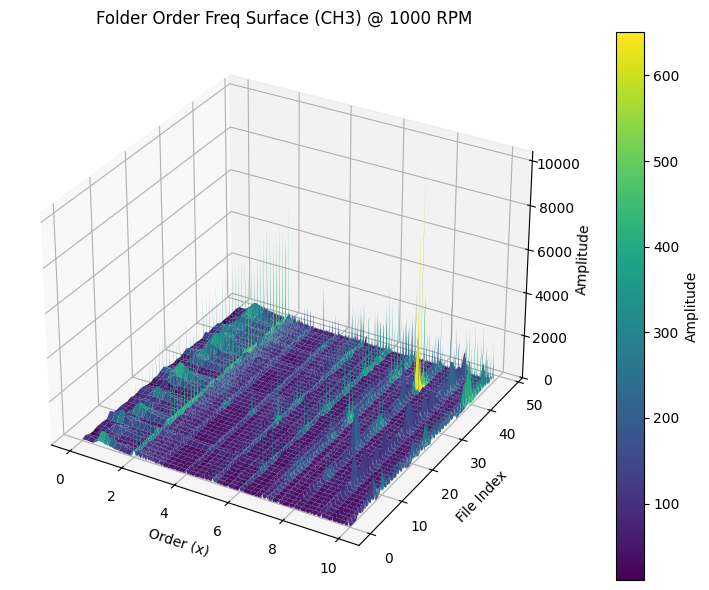

Train_Set/Train6_4_order


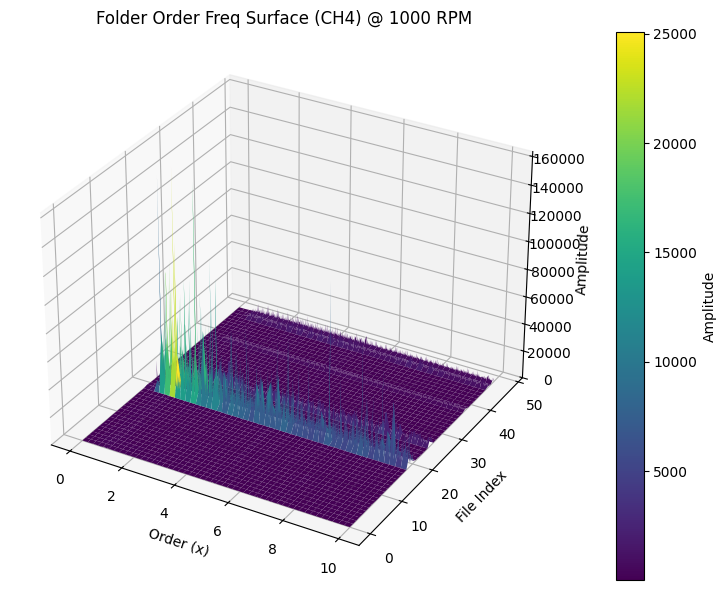

Train_Set/Train7_1_order


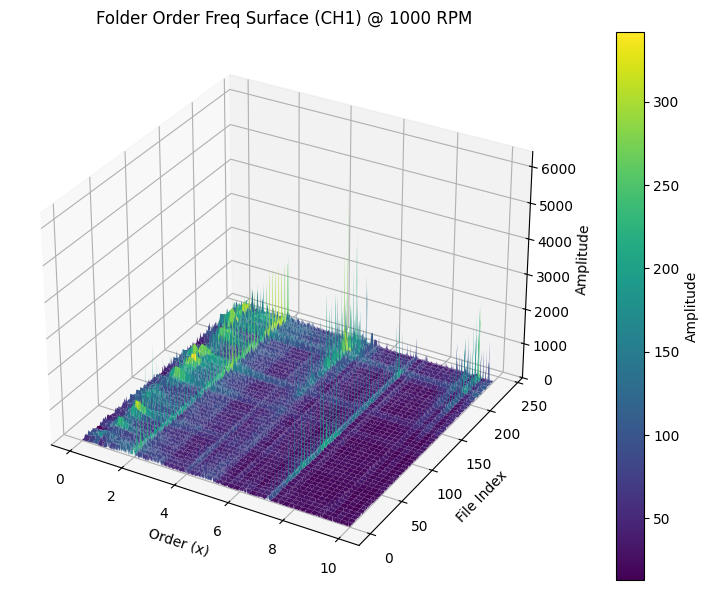

Train_Set/Train7_2_order


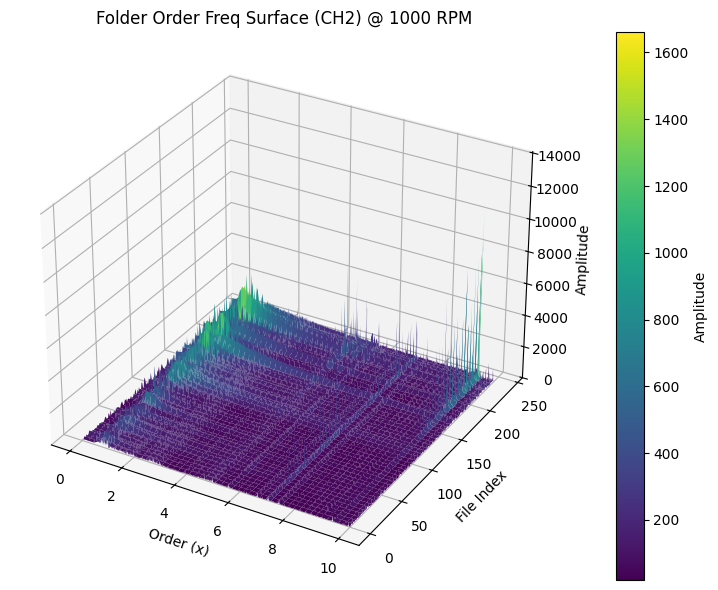

Train_Set/Train7_3_order


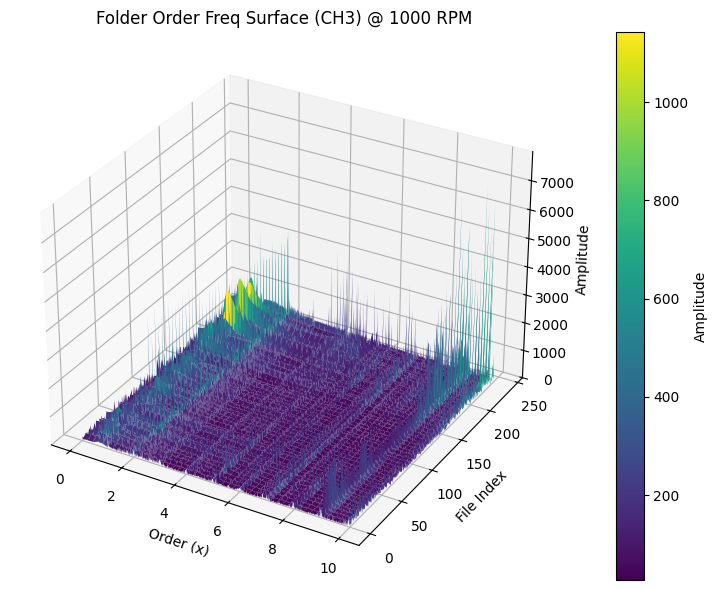

Train_Set/Train7_4_order


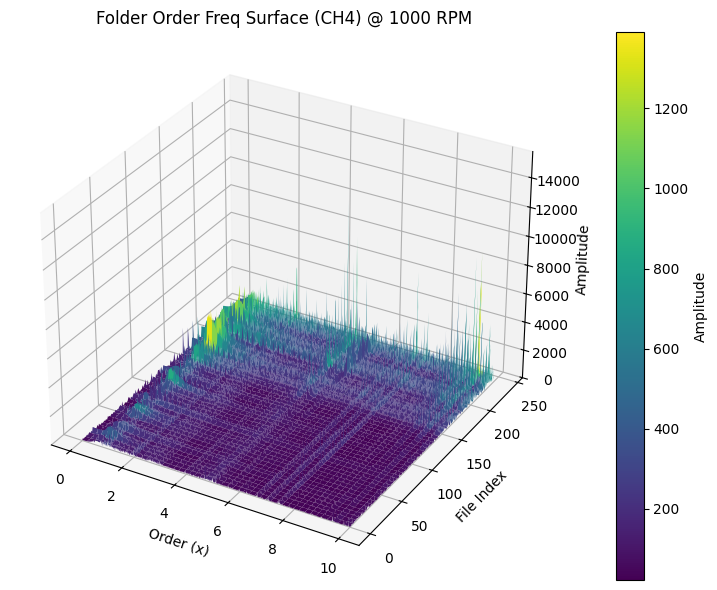

Train_Set/Train8_1_order


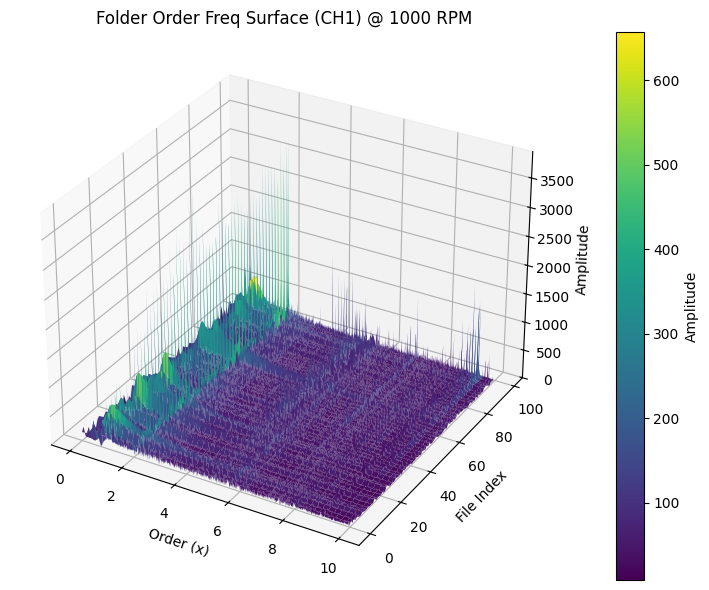

Train_Set/Train8_2_order


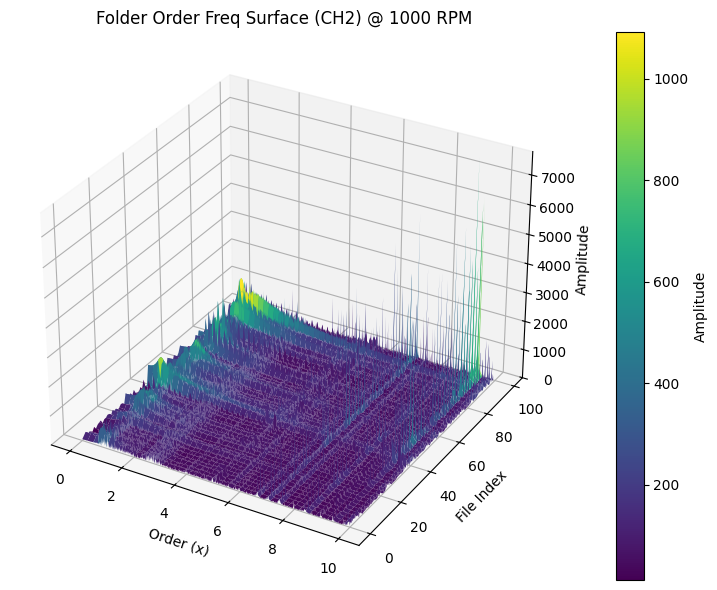

Train_Set/Train8_3_order


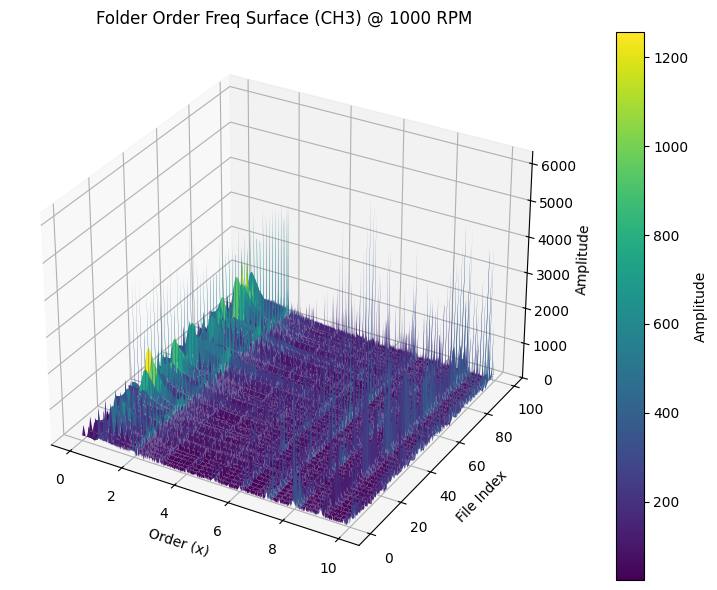

Train_Set/Train8_4_order


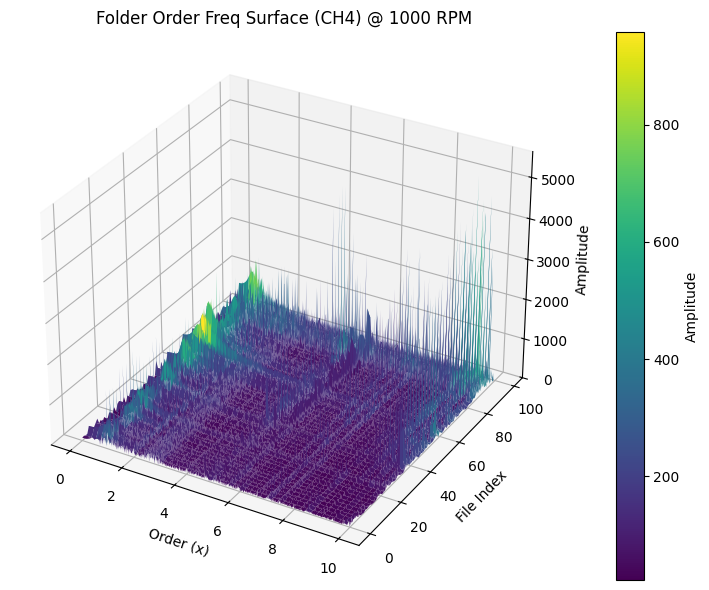

In [63]:
for Nset in range(1, 9):
    for ch in range(1, 5):
        print(f"Train_Set/Train{Nset}_{ch}_order")
        visualize_folder_order_surface(f"Train_Set/Train{Nset}", ch, rpm=1000, max_order=10)

In [71]:
def visualize_operational_data(folder_path: str, save_dir):
    """
    폴더 내 모든 TDMS 파일의 운전 데이터(Torque, TC SP Front, TC SP Rear)를
    파일 순서대로 라인 플롯으로 시각화합니다.

    :param folder_path: TDMS 파일들이 들어 있는 폴더 경로
    """
    # 1) 폴더 내 tdms 파일 리스트 
    file_list = sorted(glob(os.path.join(folder_path, "*.tdms")))
    if not file_list:
        raise FileNotFoundError(f"No .tdms files found in {folder_path}")

    # 2) 각 파일의 운전 데이터 수집
    file_names   = []
    torque_vals  = []
    front_temps  = []
    rear_temps   = []

    for fp in file_list:
        _, op = load_tdms_file(fp)
        file_names.append(os.path.basename(fp))
        torque_vals.append(op["   Torque[Nm]"])
        front_temps.append(op["   TC SP Front[℃]"])
        rear_temps.append(op["   TC SP Rear[℃]"])

    x = list(range(len(file_list)))

    # 3) 플롯 생성
    fig, ax1 = plt.subplots(figsize=(12, 5))

    # Torque (왼쪽 y축)
    ax1.plot(x, torque_vals, marker=',', label="Torque [Nm]", color='tab:blue')
    ax1.set_xlabel("File Index")
    ax1.set_ylabel("Torque [Nm]", color='tab:blue')
    ax1.tick_params(axis='y', labelcolor='tab:blue')

    # Temperature (오른쪽 y축)
    ax2 = ax1.twinx()
    ax2.plot(x, front_temps, marker=',', label="TC SP Front [℃]", color='tab:orange')
    ax2.plot(x, rear_temps,  marker=',', label="TC SP Rear [℃]",  color='tab:green')
    ax2.set_ylabel("Temperature [℃]", color='tab:orange')
    ax2.tick_params(axis='y', labelcolor='tab:orange')

    # 범례 합치기
    lines1, labels1 = ax1.get_legend_handles_labels()
    lines2, labels2 = ax2.get_legend_handles_labels()
    ax1.legend(lines1 + lines2, labels1 + labels2, loc='upper left')

    plt.title(f"Operational Data across files in '{os.path.basename(folder_path)}'")
    plt.tight_layout()

    if save_dir is None:
        save_dir = os.path.join(folder_path, "plots")
    os.makedirs(save_dir, exist_ok=True)

    # 저장 파일 이름: 폴더명 + "_operational.png"
    save_path = os.path.join(
        save_dir,
        f"{os.path.basename(folder_path.rstrip(os.sep))}_operational.png"
    )
    fig.savefig(save_path, dpi=300)
    print(f"✅ Plot saved to: {save_path}")
    
    plt.show()

Train_Set/Train1_1
✅ Plot saved to: operational_plot\Train1_operational.png


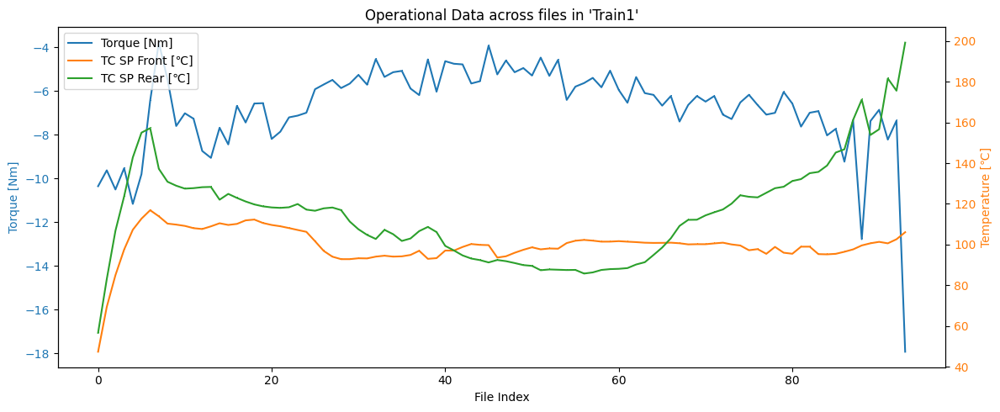

Train_Set/Train1_2
✅ Plot saved to: operational_plot\Train1_operational.png


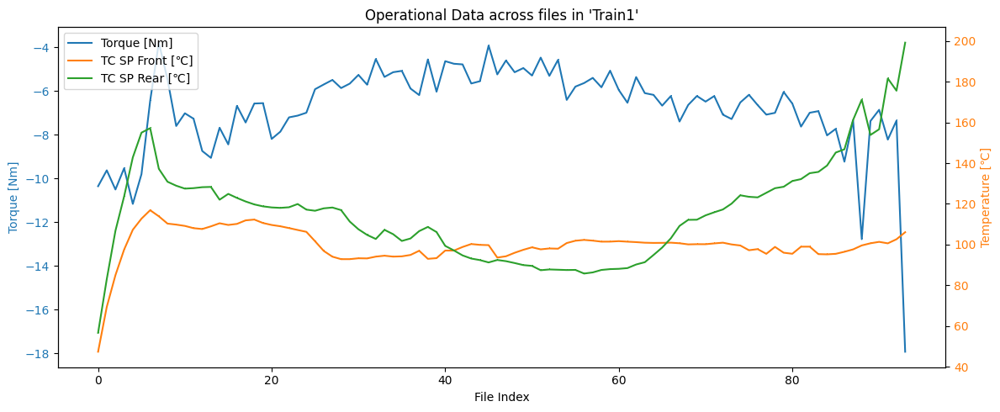

Train_Set/Train1_3
✅ Plot saved to: operational_plot\Train1_operational.png


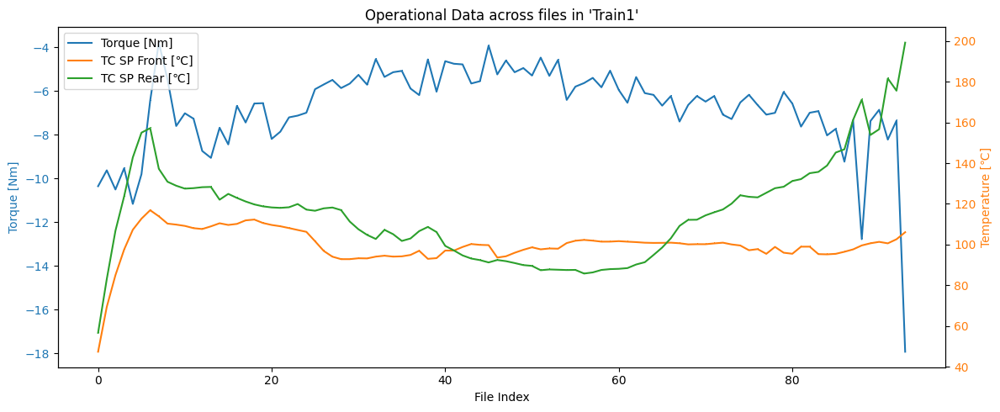

Train_Set/Train1_4
✅ Plot saved to: operational_plot\Train1_operational.png


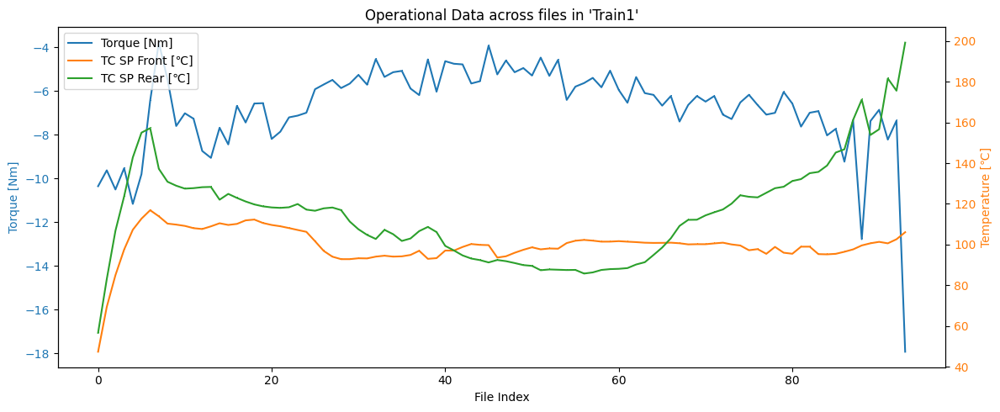

Train_Set/Train2_1
✅ Plot saved to: operational_plot\Train2_operational.png


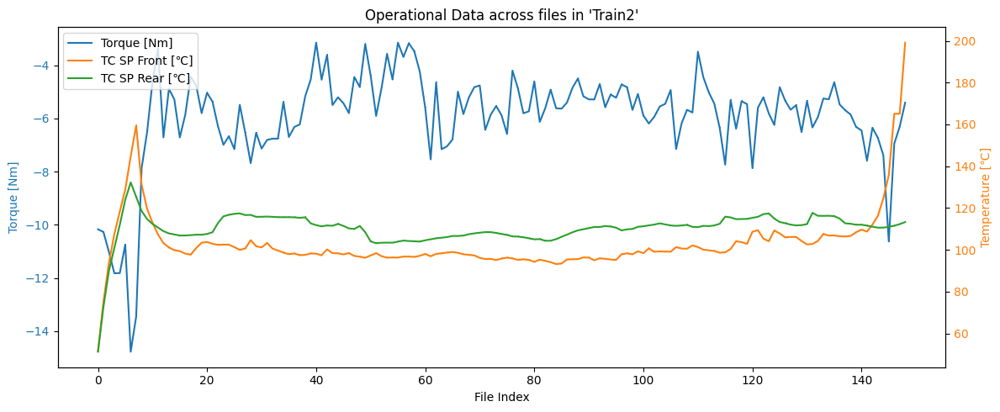

Train_Set/Train2_2
✅ Plot saved to: operational_plot\Train2_operational.png


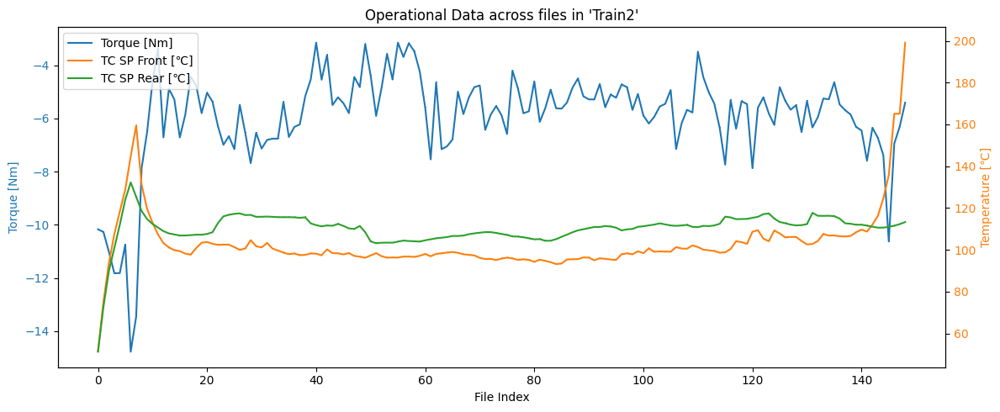

Train_Set/Train2_3
✅ Plot saved to: operational_plot\Train2_operational.png


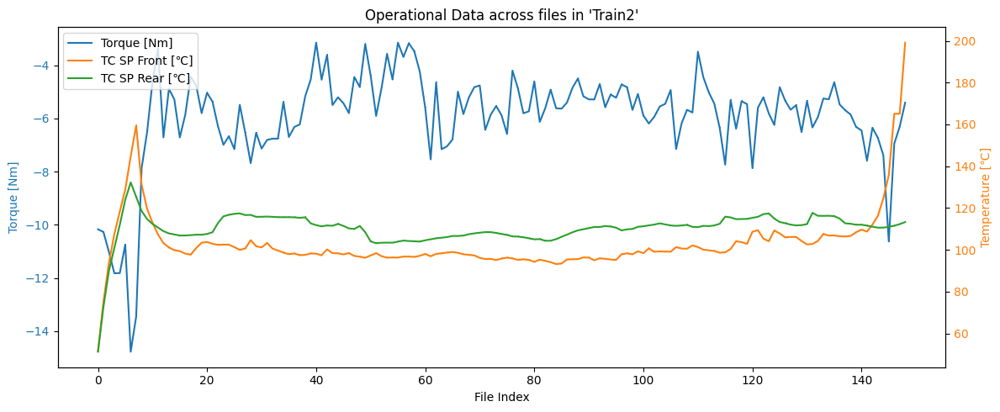

Train_Set/Train2_4
✅ Plot saved to: operational_plot\Train2_operational.png


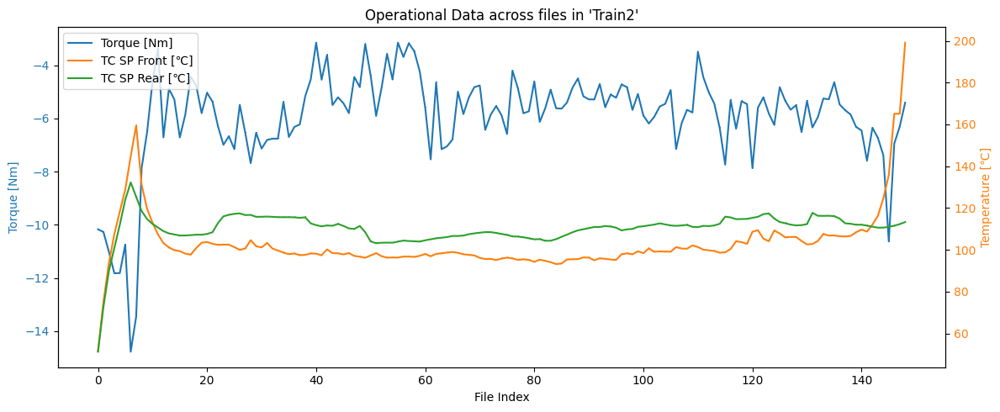

Train_Set/Train3_1
✅ Plot saved to: operational_plot\Train3_operational.png


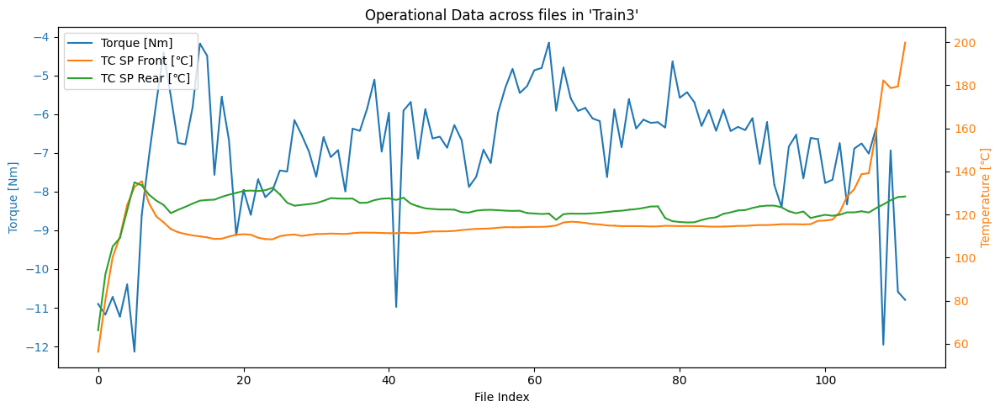

Train_Set/Train3_2
✅ Plot saved to: operational_plot\Train3_operational.png


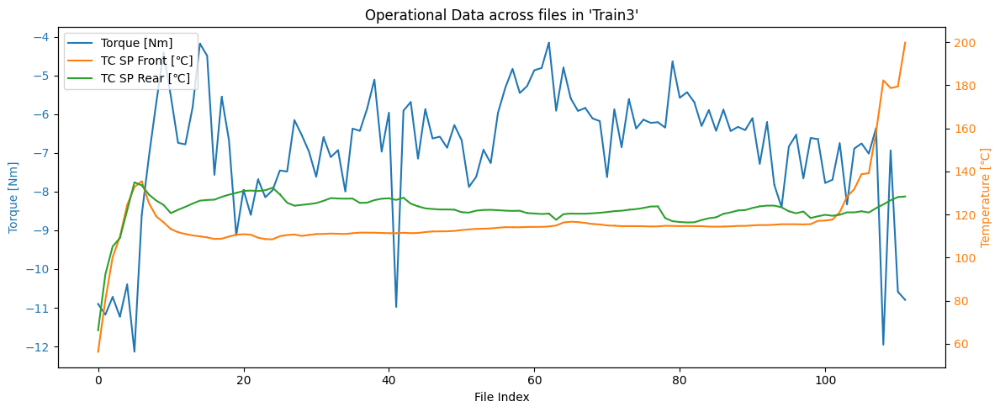

Train_Set/Train3_3
✅ Plot saved to: operational_plot\Train3_operational.png


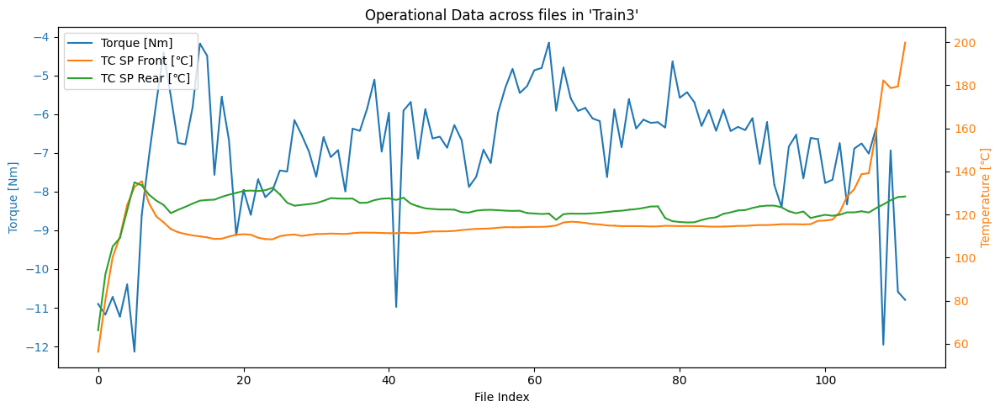

Train_Set/Train3_4
✅ Plot saved to: operational_plot\Train3_operational.png


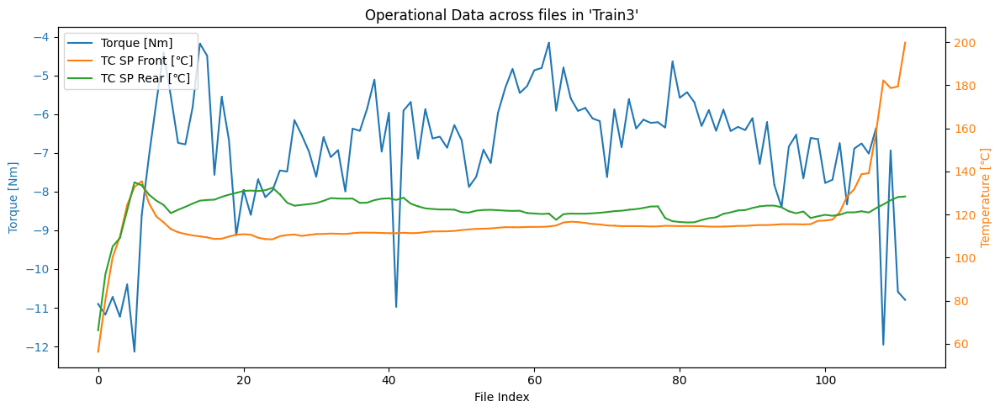

Train_Set/Train4_1
✅ Plot saved to: operational_plot\Train4_operational.png


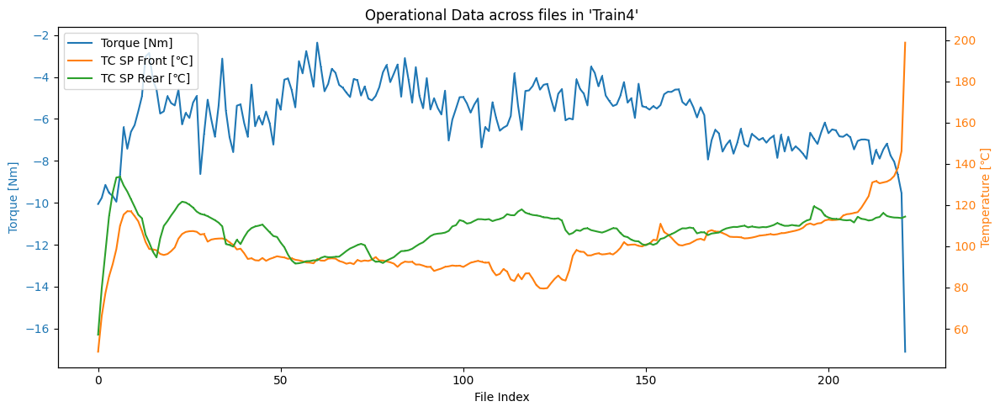

Train_Set/Train4_2
✅ Plot saved to: operational_plot\Train4_operational.png


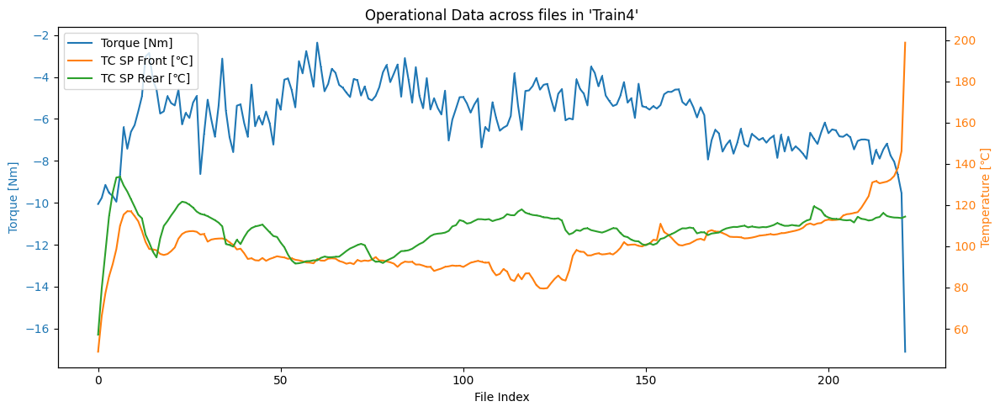

Train_Set/Train4_3
✅ Plot saved to: operational_plot\Train4_operational.png


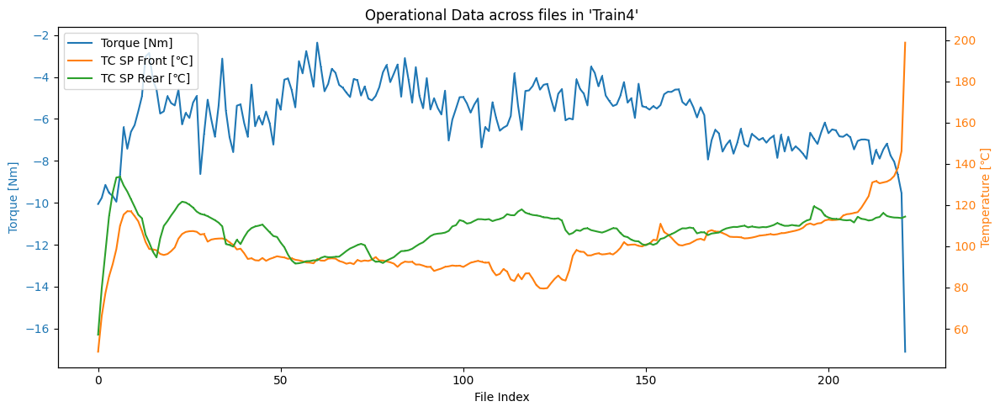

Train_Set/Train4_4
✅ Plot saved to: operational_plot\Train4_operational.png


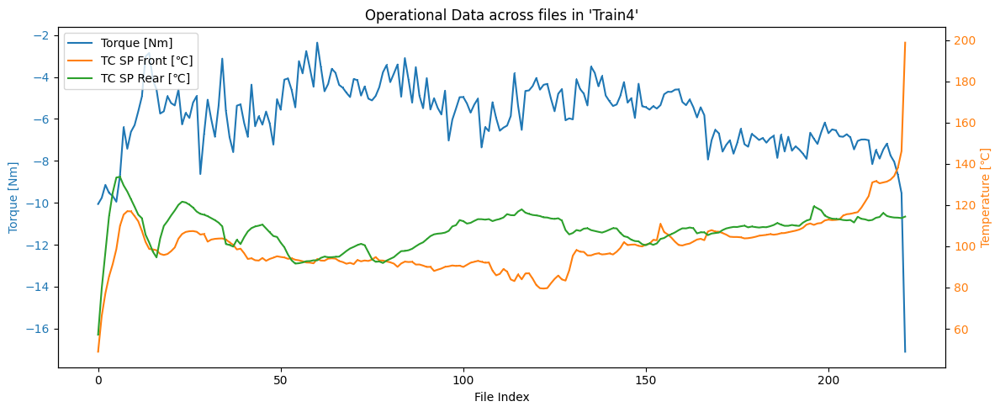

Train_Set/Train5_1
✅ Plot saved to: operational_plot\Train5_operational.png


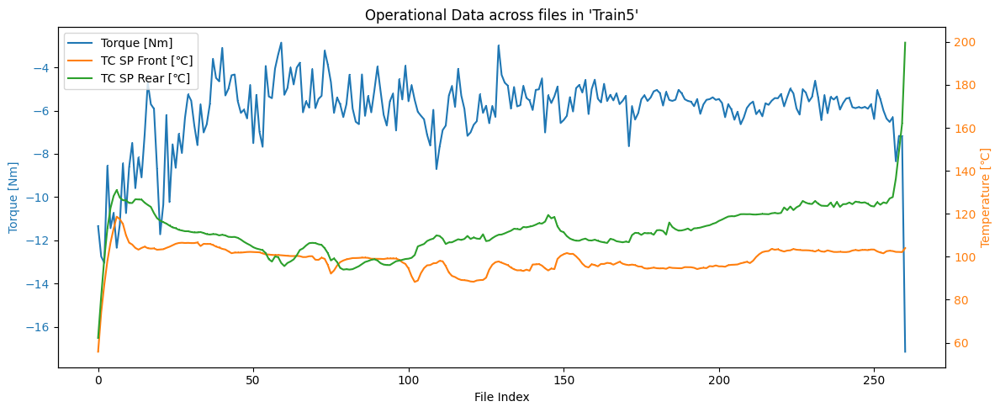

Train_Set/Train5_2
✅ Plot saved to: operational_plot\Train5_operational.png


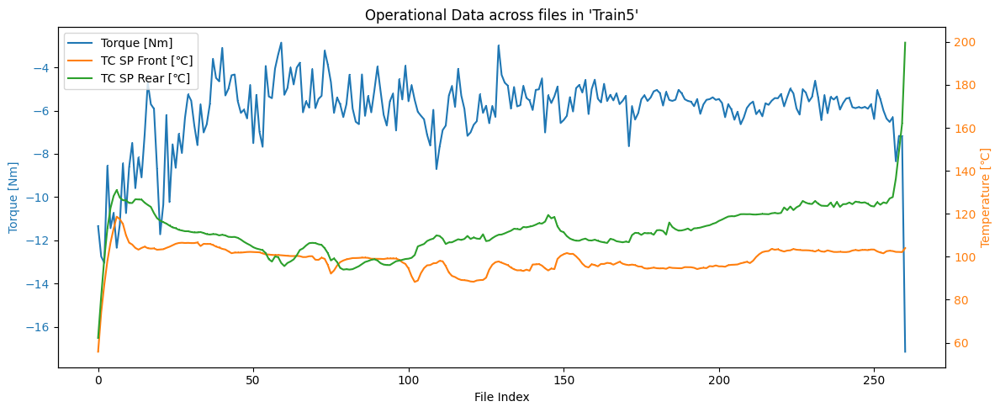

Train_Set/Train5_3
✅ Plot saved to: operational_plot\Train5_operational.png


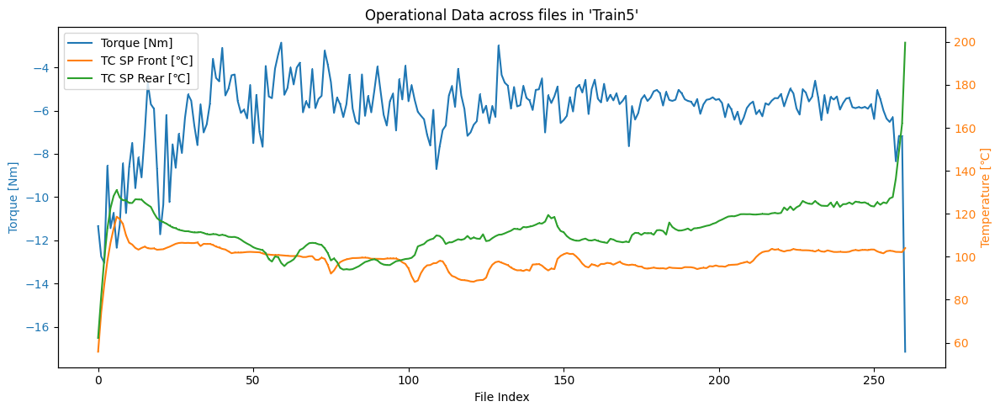

Train_Set/Train5_4
✅ Plot saved to: operational_plot\Train5_operational.png


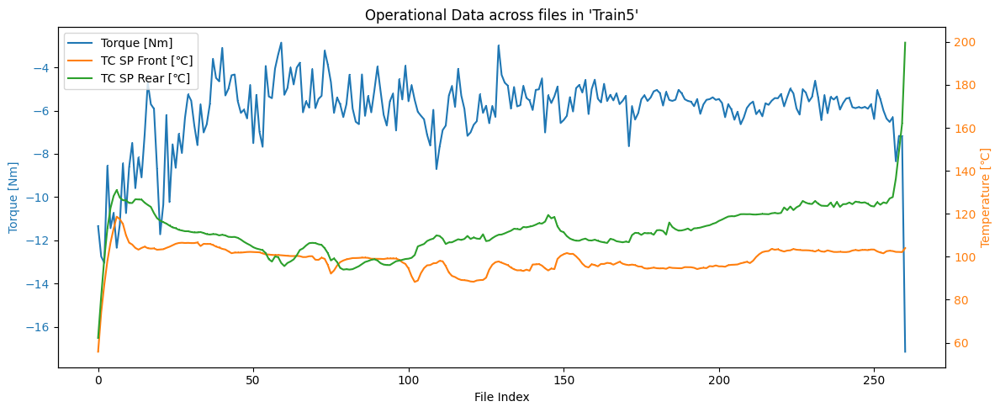

Train_Set/Train6_1
✅ Plot saved to: operational_plot\Train6_operational.png


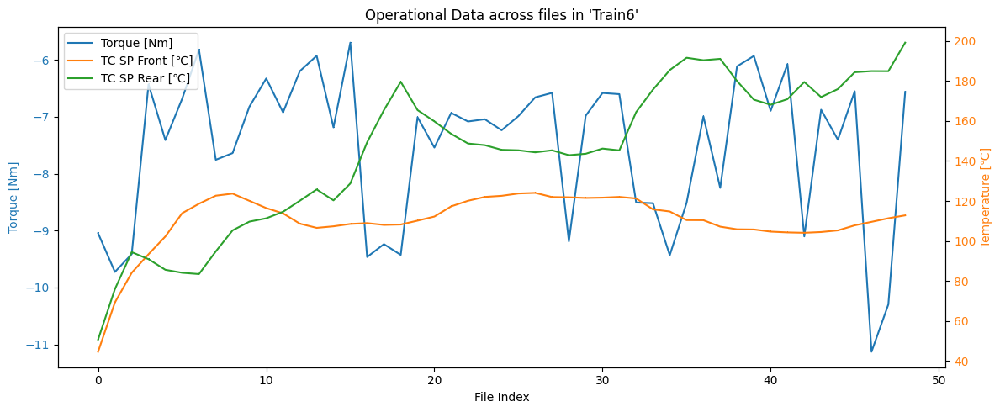

Train_Set/Train6_2
✅ Plot saved to: operational_plot\Train6_operational.png


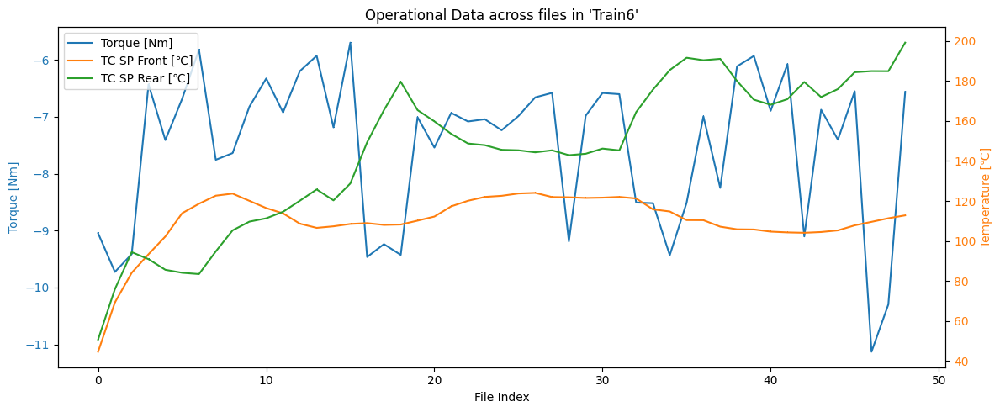

Train_Set/Train6_3
✅ Plot saved to: operational_plot\Train6_operational.png


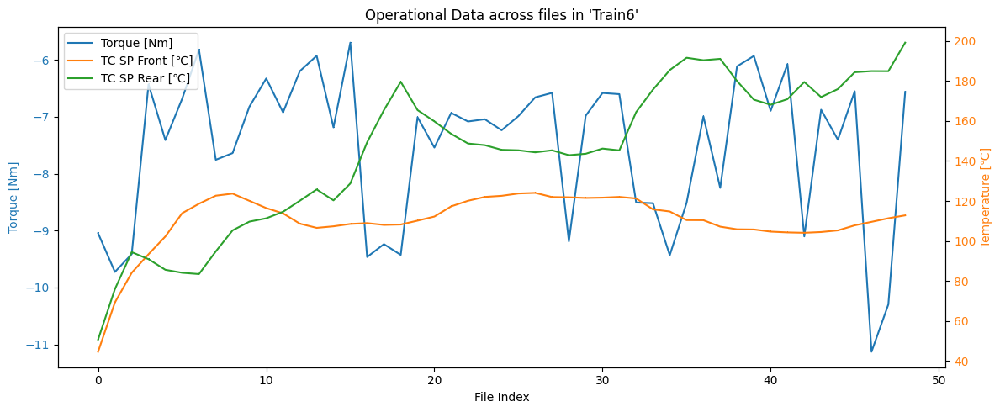

Train_Set/Train6_4
✅ Plot saved to: operational_plot\Train6_operational.png


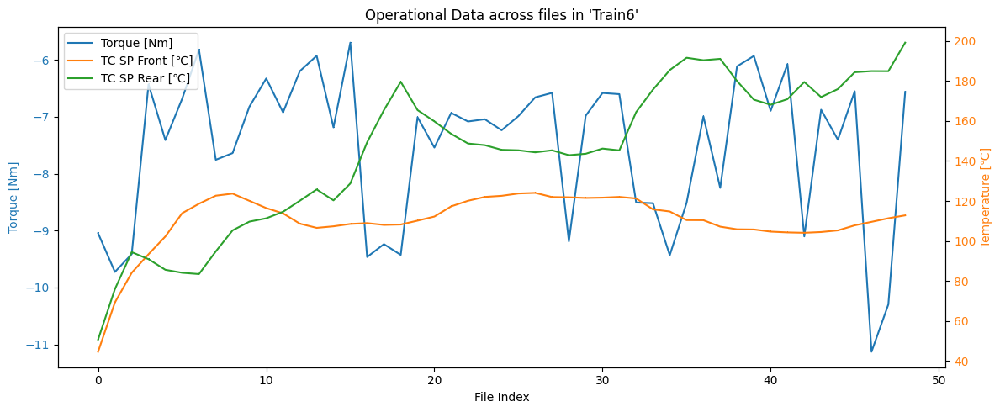

Train_Set/Train7_1
✅ Plot saved to: operational_plot\Train7_operational.png


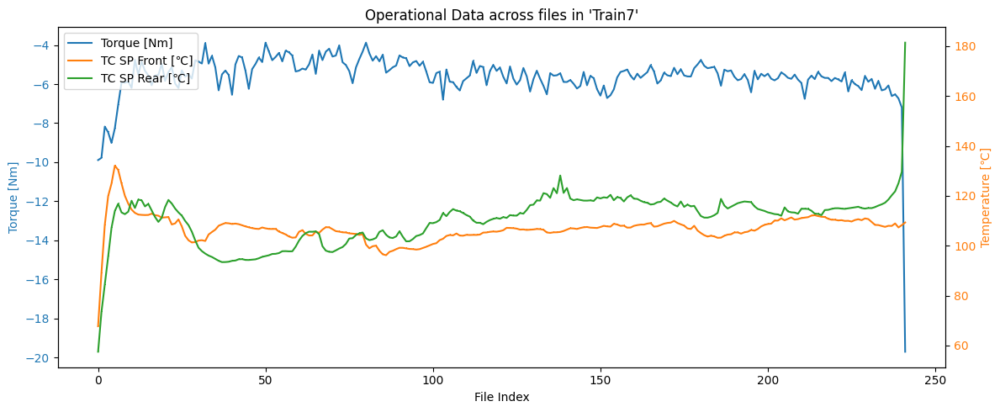

Train_Set/Train7_2
✅ Plot saved to: operational_plot\Train7_operational.png


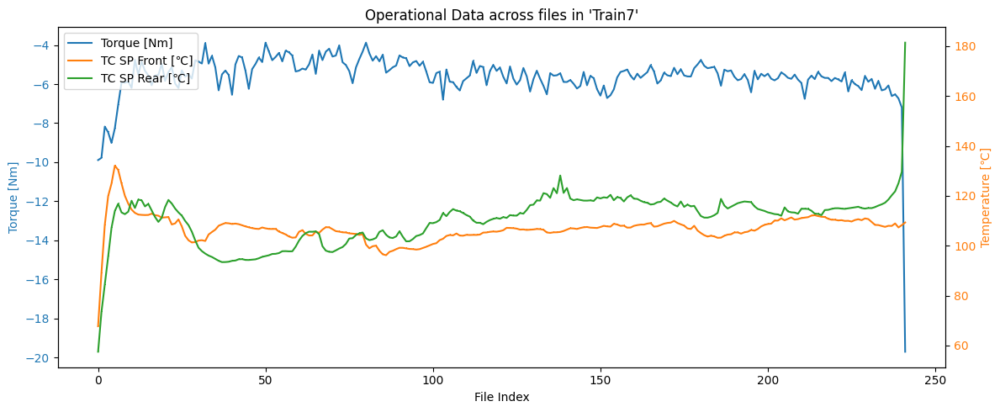

Train_Set/Train7_3
✅ Plot saved to: operational_plot\Train7_operational.png


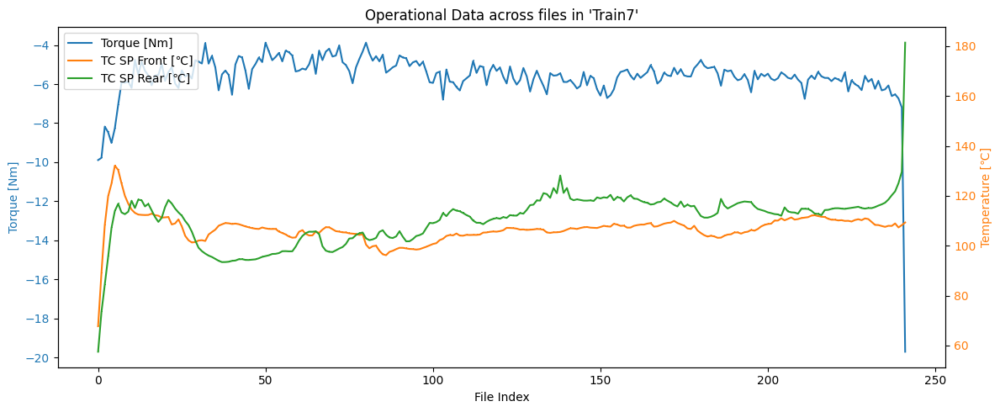

Train_Set/Train7_4
✅ Plot saved to: operational_plot\Train7_operational.png


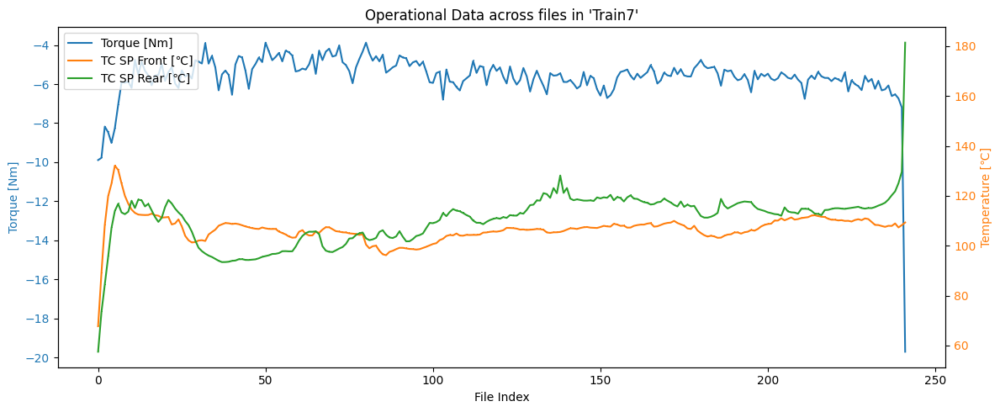

Train_Set/Train8_1
✅ Plot saved to: operational_plot\Train8_operational.png


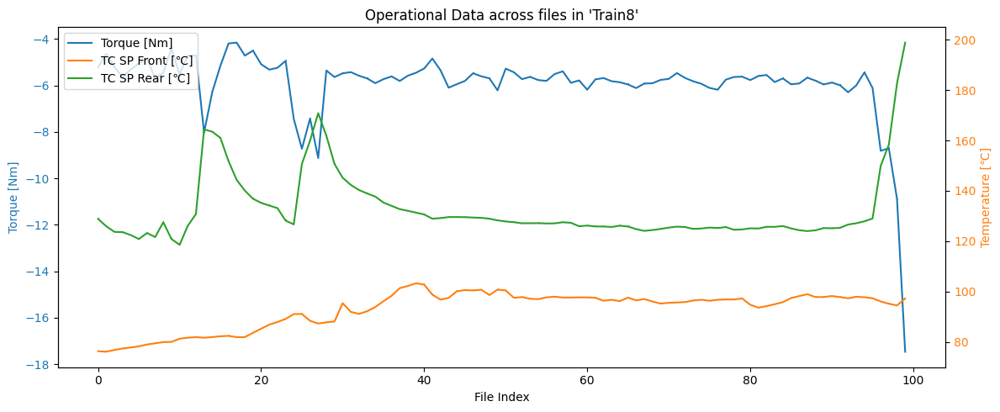

Train_Set/Train8_2
✅ Plot saved to: operational_plot\Train8_operational.png


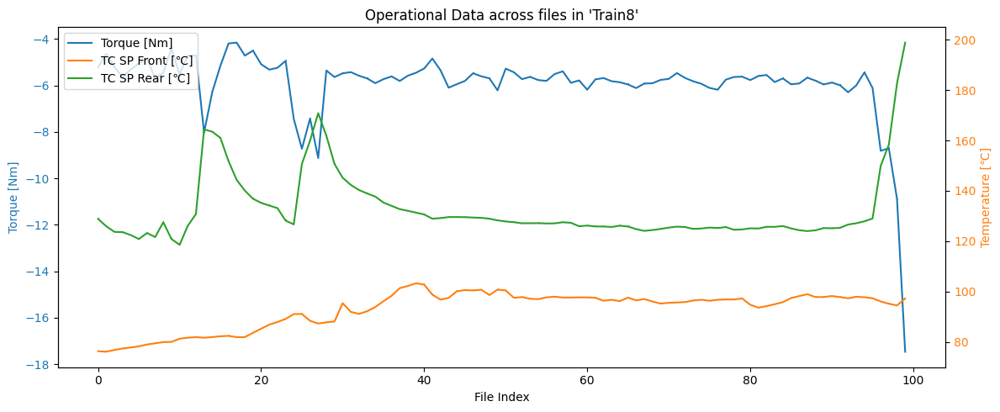

Train_Set/Train8_3
✅ Plot saved to: operational_plot\Train8_operational.png


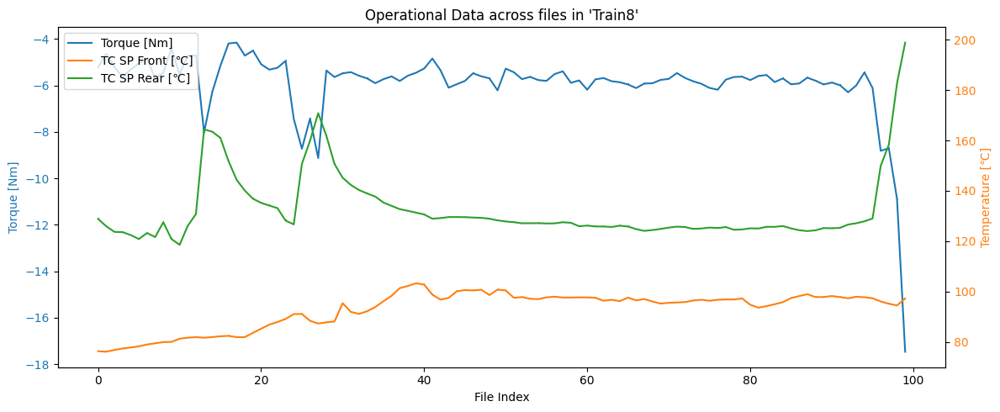

Train_Set/Train8_4
✅ Plot saved to: operational_plot\Train8_operational.png


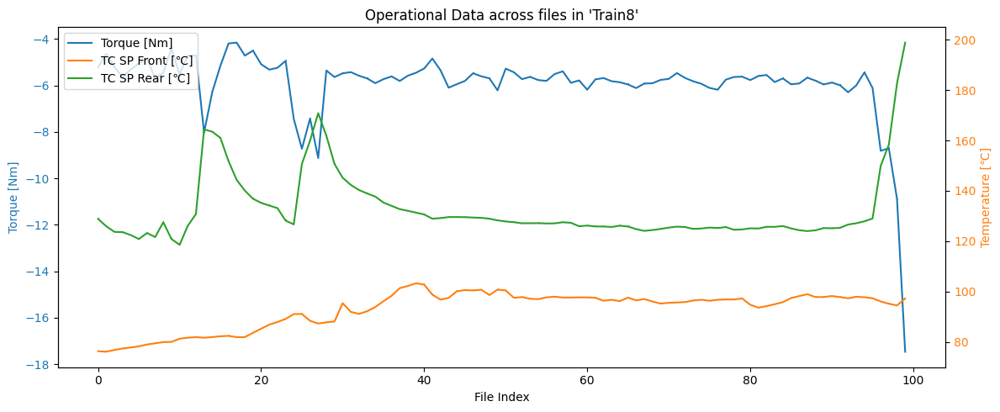

In [72]:
for Nset in range(1, 9):
    for ch in range(1, 5):
        print(f"Train_Set/Train{Nset}_{ch}")
        visualize_operational_data(f"Train_Set\Train{Nset}", "operational_plot")

In [ ]:
import torch
from tqdm import tqdm
def cache_features(data_folder, out_pt, rpm=1000, fs=25600, segment_len=2560, stride=1280):
    if data_folder == "Train_Set":
        files = sorted(glob(os.path.join(data_folder, "Train*", "*.tdms")))
    elif data_folder == "Validation_Set":
        files = sorted(glob(os.path.join(data_folder, "Validation*", "*.tdms")))
    elif data_folder == "Test_Set":
        files = sorted(glob(os.path.join(data_folder, "Test*", "*.tdms")))
    rows = []
    for fp in tqdm(files, desc="Processing .tdms files"):
        vib, op = load_tdms_file(fp)
        row = {"file": os.path.basename(fp), **op}

        for ch, sig in vib.items():

            slices = [sig[i:i+segment_len] for i in range(0, len(sig) - segment_len + 1, stride)]

            for idx, slice_ in enumerate(slices):
                filt = bandpass_filter(slice_)
                tfeat = extract_time_features(filt)
                row.update({f"{ch}_{k}": v for k, v in tfeat.items()})

                freqs, fvals = compute_fft(filt)
                ffeat = extract_fft_features(freqs, fvals)
                row.update({f"{ch}_{k}": v for k, v in ffeat.items()})

                orders, oval = compute_order_spectrum(filt, fs=25600, rpm=rpm)
                ofeat = extract_order_features(orders, oval, max_order=600)
                row.update({f"{ch}_{k}":v for k, v in ofeat.items()})

                rows.append(row)
        
        if len(row) > 0:
            rows.append(row)

    torch.save(rows, out_pt)
    print(f"Saved {out_pt}")

In [45]:
cache_features("Train_Set", "Train_features.pt", rpm=1000)

Processing .tdms files: 100%|██████████| 1229/1229 [09:05<00:00,  2.25it/s]


Saved Train_features.pt


In [46]:
cache_features("Validation_Set", "Val_dataset.pt", rpm=1000)

Processing .tdms files: 100%|██████████| 269/269 [01:53<00:00,  2.37it/s]


Saved Val_dataset.pt


In [47]:
cache_features("Test_Set", "Test_dataset.pt", rpm=1000)

Processing .tdms files: 100%|██████████| 44/44 [00:18<00:00,  2.39it/s]


Saved Test_dataset.pt


In [64]:
def extract_rms(x):
    return np.sqrt(np.mean(np.square(x)))

In [1]:
def extract_rms_band_features(signal, fs=25600, band_width=100):
    fft_vals = np.abs(rfft(signal))
    freqs = rfftfreq(len(signal), d=1/fs)

    bands = []
    for start in range(0, len(freqs), band_width):
        end = start + band_width
        mask = (freqs >= start) & (freqs < end)
        band = fft_vals[mask]
        if len(band) > 0:
            rms = np.sqrt(np.mean(band ** 2))
        else:
            rms = 0.0
        bands.append(rms)

    return np.array(bands)

In [ ]:
def cache_rms(data_folder, output_path="./cachedRMS", fs=25600, lowcut=10, highcut=10000):
    if data_folder == "Train_Set":
        files = sorted(glob(os.path.join(data_folder, "Train*", "*.tdms")))
    elif data_folder == "Validation_Set":
        files = sorted(glob(os.path.join(data_folder, "Validation*", "*.tdms")))
    elif data_folder == "Test_Set":
        files = sorted(glob(os.path.join(data_folder, "Test*", "*.tdms")))

    if output_path:
        os.makedirs(output_path, exist_ok=True)
    data = []

    for path in tqdm(files, desc="caching RMS features"):
        vib_data, op_data = load_tdms_file(path)
        for ch, sig in vib_data.items():
            filt = bandpass_filter(sig, fs, lowcut, highcut)
            rms = extract_rms_band_features(filt, fs=fs)

            data.append({
                "file": os.path.basename(path),
                "channel": ch,
                "rms": torch.tensor(rms, dtype=torch.float32),
                "op": {k: torch.tensor(v, dtype=torch.float32) for k, v in op_data.items()}
            })
    save_path = os.path.join(output_path, f"{data_folder}_RMS.pt")
    torch.save(data, save_path)
    print(f"Cached data saved to {output_path}")

In [68]:
cache_rms("Train_Set")

caching RMS features: 100%|██████████| 1229/1229 [00:36<00:00, 33.71it/s]


Cached data saved to ./cachedRMS


In [69]:
cache_rms("Validation_Set")

caching RMS features: 100%|██████████| 269/269 [00:26<00:00,  9.99it/s]

Cached data saved to ./cachedRMS


In [70]:
cache_rms("Test_Set")

caching RMS features: 100%|██████████| 44/44 [00:04<00:00,  9.49it/s]

Cached data saved to ./cachedRMS
